In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import datasets
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!
from torchsummary import summary
import torch.nn.functional as F

# library to get dataloader
from dataloaders import get_pkmn_dataloader

# library to get loss functions
from loss_functions import *

# generators and discriminators
from DCGeneratorCustom import DCGeneratorCustom
from DCDiscriminatorCustom import DCDiscriminatorCustom
from DCGeneratorStandard import DCGeneratorStandard
from DCDiscriminatorStandard import DCDiscriminatorStandard

# util methods
from utils import get_noise


In [63]:
print(torch.__version__)

# if apply_denormalization is true, then we re-scale the images back 
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), denorm_transform = None, use_uniform_transform = False):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    
    # We don't specifically need this since we are doing the denormalization ourself
    
    if denorm_transform is not None:
      assert use_uniform_transform == False
      image_tensor = denorm_transform(image_tensor)
    if use_uniform_transform:
      # cannot use both uniform and denorm transform together
      assert denorm_transform == None
      image_tensor = (image_tensor + 1) / 2 # scale from [-1, 1] to [0, 1] space
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def save_model(model, output_filename):
  torch.save(model.state_dict(), output_filename)

1.10.2


In [3]:
# playing around with the generator the output shape. These layers give an output shape of 64
show_summary = True
test_batch_size = 4

test_gen = DCGeneratorStandard(hidden_dim = 64)
out = test_gen(torch.ones(test_batch_size,16))

assert out.shape[0] == test_batch_size
assert out.shape[1] == 3 # output should have 3 channels (r,g,b)
assert out.shape[2] == test_gen.output_dim # output should have the proper [width, height]

# shape does not include the batch size
if show_summary:
  summary(test_gen, (1,16))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         131,584
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,408
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,416
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,136
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,075
             Tanh-14            [-1, 3,

In [4]:
# playing around with the discriminator and the output shape
show_summary = True
test_batch_size = 7

test_disc = DCDiscriminatorStandard(hidden_dim = 30)
out = test_disc(torch.ones(test_batch_size, 3, 64, 64))

print(out.shape)

# output shape is (1,64) ---> why does it have 64 dimensions ? Don't we want a single prediction between 0 and 1 ?
assert out.shape[0] == test_batch_size
assert out.shape[1] == 1 # should only have one probability for the output

if show_summary:
  summary(test_disc, (3, 64, 64))

torch.Size([7, 1])
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 30, 32, 32]           1,470
       BatchNorm2d-2           [-1, 30, 32, 32]              60
         LeakyReLU-3           [-1, 30, 32, 32]               0
            Conv2d-4           [-1, 60, 16, 16]          28,860
       BatchNorm2d-5           [-1, 60, 16, 16]             120
         LeakyReLU-6           [-1, 60, 16, 16]               0
            Conv2d-7            [-1, 120, 8, 8]         115,320
       BatchNorm2d-8            [-1, 120, 8, 8]             240
         LeakyReLU-9            [-1, 120, 8, 8]               0
           Conv2d-10            [-1, 240, 4, 4]         461,040
      BatchNorm2d-11            [-1, 240, 4, 4]             480
        LeakyReLU-12            [-1, 240, 4, 4]               0
           Conv2d-13              [-1, 1, 1, 1]           3,841
          Sigmoid-14

In [5]:
# ======= Define the basic hyper-parameters =====


# training epochs (50 seems to work well, takes a while before it generates good results)
n_epochs = 50
# dimension of noise vector
z_dim = 32
hidden_dim_gen = 64
hidden_dim_disc = 30
batch_size = 32
# how often to display images (this is the # of batches that have to be processed)
# Basically, we want to display images after processing the entire dataset (about 5000 images)
display_step = int((4000 / batch_size))
imgs_to_display = 9
save_at_display = True
save_prefix = "dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss"

print("Planning to display images every {} steps".format(display_step))

# other sources say 0.00275 works better...but the DCGAn paper used 0.0002 (ie. about 10-4 instead of 10-3)
gen_lr = 0.0002 # 0.0002 works for both, but takes at least 10-15 epochs before anything interesting happens?
disc_lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
disc_repeats = 1
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# loss functions
gen_loss_func = get_generator_loss_func("basic_gen_loss")
disc_loss_func = get_disc_loss_func("noisy_disc_loss")

assert imgs_to_display <= batch_size

Planning to display images every 125 steps


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/1234 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


[Dataloader Stats] Final mean per channel is: tensor([0.8914, 0.8799, 0.8626]), final std per channel is: tensor([0.2061, 0.2198, 0.2390])


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


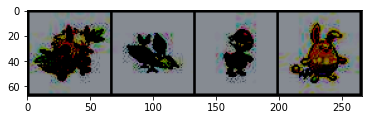

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


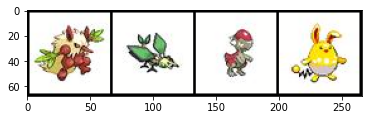

In [6]:
# Create the dataloader, based on the appropriate batch size. 

show_preview = True
dataloader_name = "shiny_64_dim_normalize_and_random_transform_from_data"
pkmn_dataloader, denorm_transform = get_pkmn_dataloader(dataloader_name, batch_size)
test_size = 4

# show a batch before and after denorm
test_data_iter = iter(pkmn_dataloader)
test_images, test_labels = next(test_data_iter)

# shape = (bs, num_channels, width, height)
#print(test_images.shape)
#print(test_labels)

if show_preview:
  show_tensor_images(test_images[0:test_size], num_images = test_size, size = (3,64,64), denorm_transform = None)
  show_tensor_images(test_images[0:test_size], num_images = test_size, size = (3,64,64), denorm_transform = denorm_transform)


In [7]:
# Create the generator/discriminator and use them
# layer initialization for Generator and Discriminator (for Conv2d and ConvTranpose2d)

gen = DCGeneratorStandard(z_dim = z_dim, hidden_dim = hidden_dim_gen).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=gen_lr, betas=(beta_1, beta_2))
disc = DCDiscriminatorStandard(hidden_dim = hidden_dim_disc).to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=disc_lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 125: Epoch: 0: Generator loss: 3.338457501411438, discriminator loss: 0.3053008416891098 mean disc pred on real images: 0.8609967827796936, fake images: 0.13893923163414001


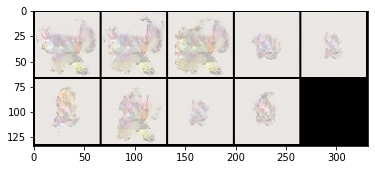

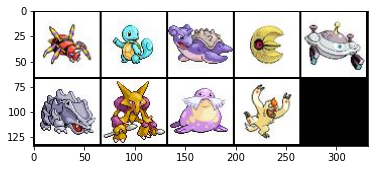

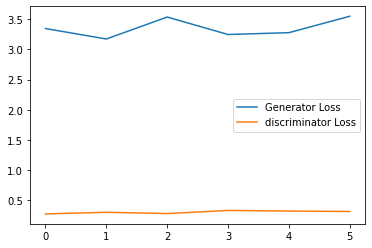

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 250: Epoch: 1: Generator loss: 2.955239634513855, discriminator loss: 0.2703763703107834 mean disc pred on real images: 0.8720642328262329, fake images: 0.12431751191616058


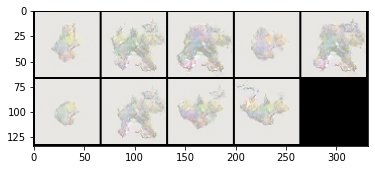

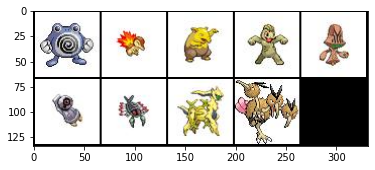

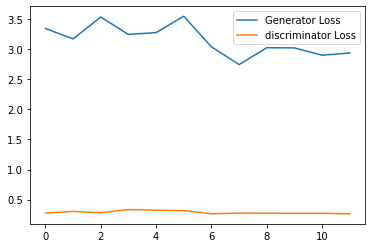

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 375: Epoch: 2: Generator loss: 3.1711800475120544, discriminator loss: 0.27335085916519164 mean disc pred on real images: 0.8773348927497864, fake images: 0.12191160768270493


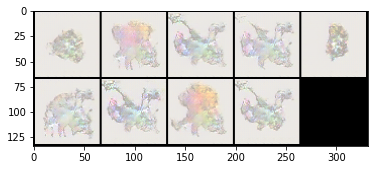

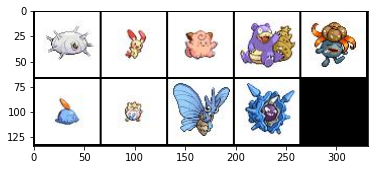

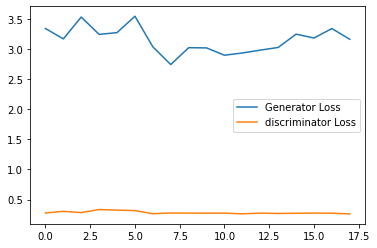

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 500: Epoch: 3: Generator loss: 3.104381123304367, discriminator loss: 0.29613571560382845 mean disc pred on real images: 0.8684576749801636, fake images: 0.13134944438934326


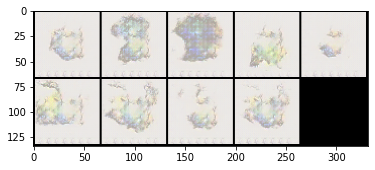

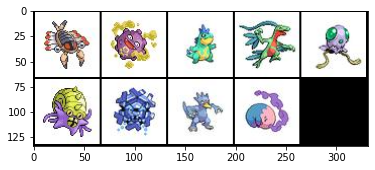

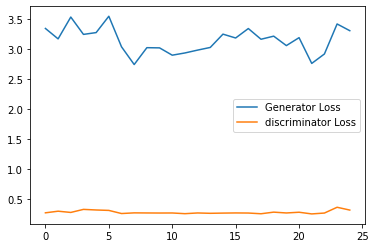

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 625: Epoch: 4: Generator loss: 3.064760444164276, discriminator loss: 0.2940691225528717 mean disc pred on real images: 0.8588047623634338, fake images: 0.14208830893039703


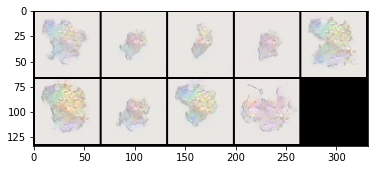

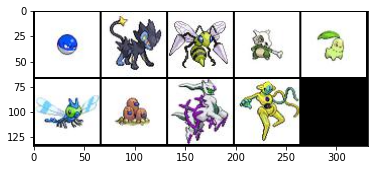

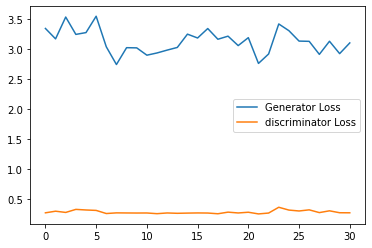

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 750: Epoch: 4: Generator loss: 2.9389815731048583, discriminator loss: 0.273250554561615 mean disc pred on real images: 0.8715075254440308, fake images: 0.12770259380340576


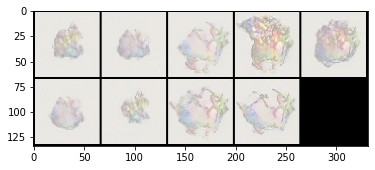

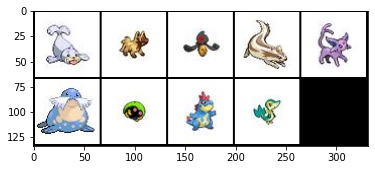

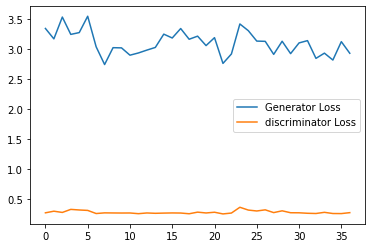

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 875: Epoch: 5: Generator loss: 3.134022682905197, discriminator loss: 0.28121323096752165 mean disc pred on real images: 0.8742296695709229, fake images: 0.12616319954395294


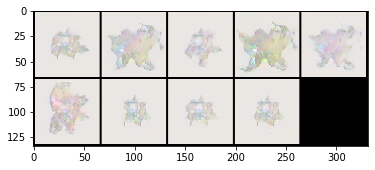

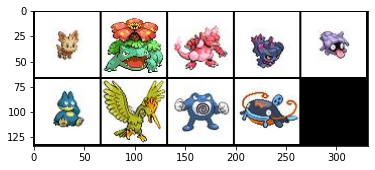

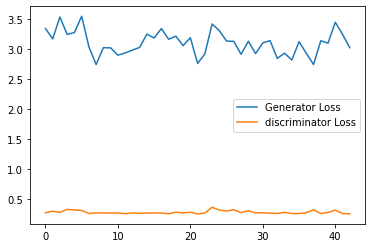

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1000: Epoch: 6: Generator loss: 3.135815854549408, discriminator loss: 0.2550759071111679 mean disc pred on real images: 0.8926423192024231, fake images: 0.10569962859153748


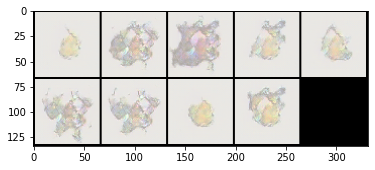

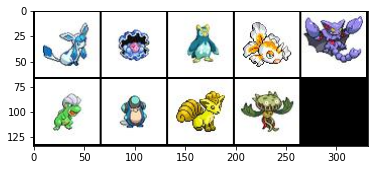

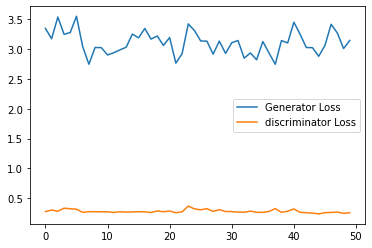

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_1000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1125: Epoch: 7: Generator loss: 3.189700481414795, discriminator loss: 0.2737848867177963 mean disc pred on real images: 0.8860278129577637, fake images: 0.11554549634456635


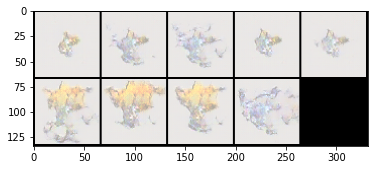

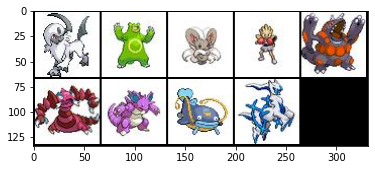

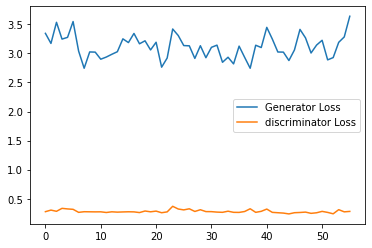

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1250: Epoch: 8: Generator loss: 3.0202631149291994, discriminator loss: 0.2697834286689758 mean disc pred on real images: 0.8839772939682007, fake images: 0.11445781588554382


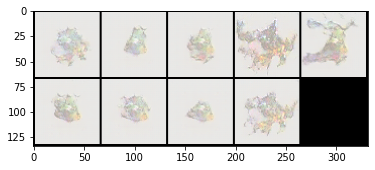

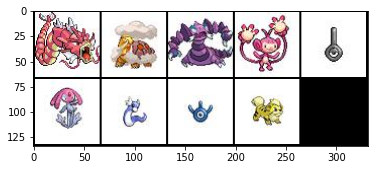

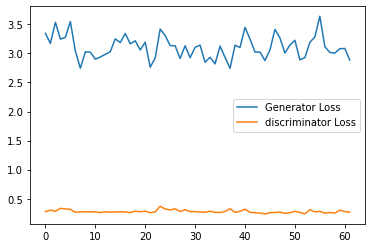

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_1250.pt !
Step 1375: Epoch: 8: Generator loss: 3.129354118824005, discriminator loss: 0.2612866098880768 mean disc pred on real images: 0.8926591277122498, fake images: 0.10854920744895935


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


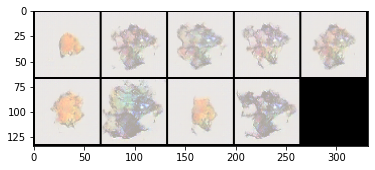

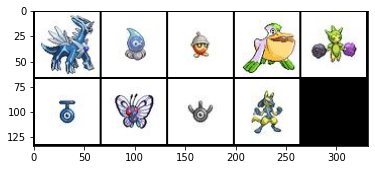

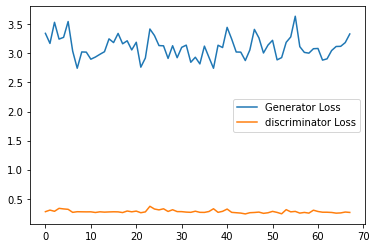

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1500: Epoch: 9: Generator loss: 3.0703927841186522, discriminator loss: 0.25489344251155854 mean disc pred on real images: 0.895630419254303, fake images: 0.10490330308675766


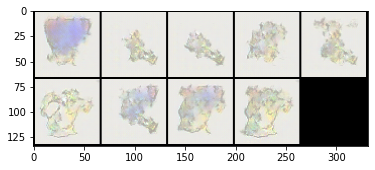

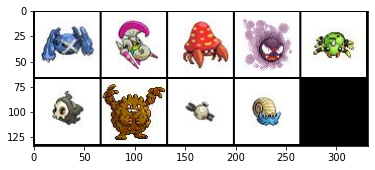

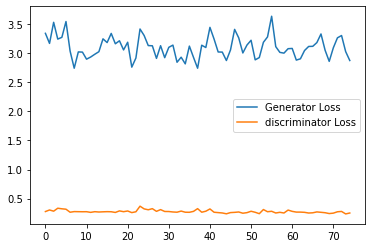

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_1500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1625: Epoch: 10: Generator loss: 3.31180654835701, discriminator loss: 0.27350964426994323 mean disc pred on real images: 0.8873388767242432, fake images: 0.11283702403306961


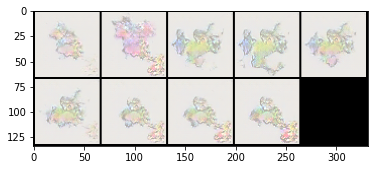

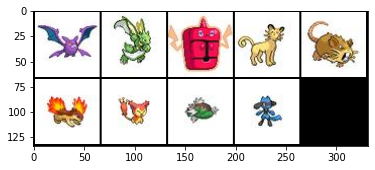

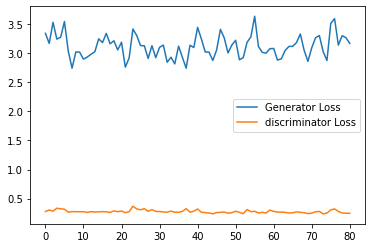

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1750: Epoch: 11: Generator loss: 3.0886422481536866, discriminator loss: 0.2647755969762802 mean disc pred on real images: 0.8883674144744873, fake images: 0.11317524313926697


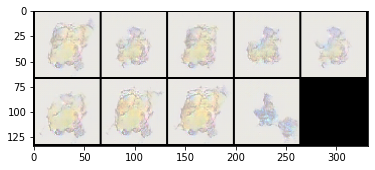

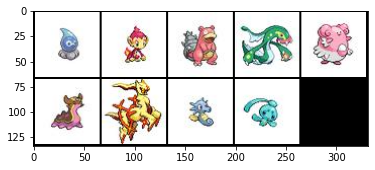

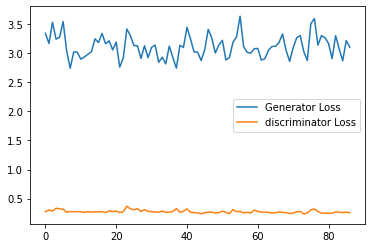

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_1750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1875: Epoch: 12: Generator loss: 3.091232514858246, discriminator loss: 0.25588455760478973 mean disc pred on real images: 0.8955118656158447, fake images: 0.10296231508255005


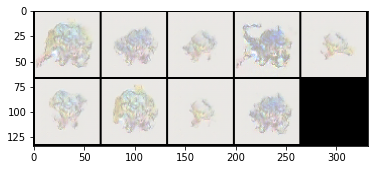

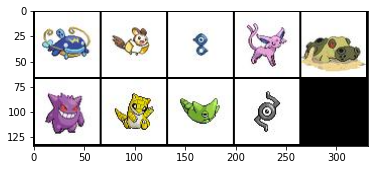

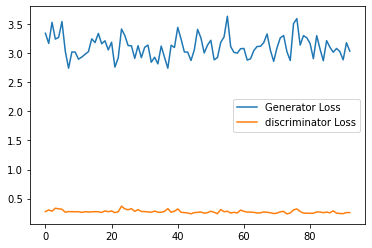

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2000: Epoch: 12: Generator loss: 3.380227144241333, discriminator loss: 0.27476469445228574 mean disc pred on real images: 0.8894975781440735, fake images: 0.11189678311347961


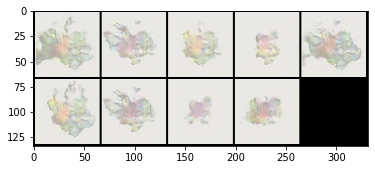

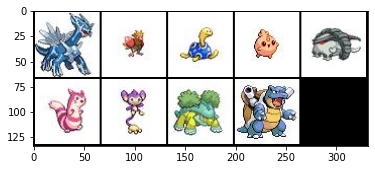

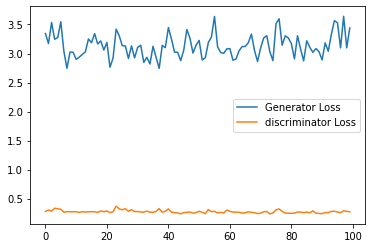

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_2000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2125: Epoch: 13: Generator loss: 3.163160012960434, discriminator loss: 0.27650470662117005 mean disc pred on real images: 0.880910336971283, fake images: 0.11754371970891953


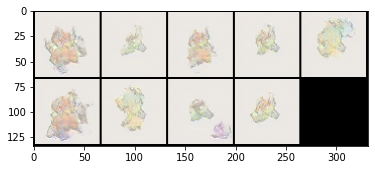

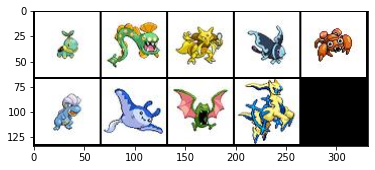

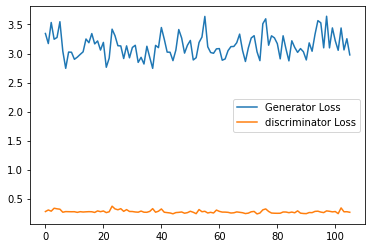

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2250: Epoch: 14: Generator loss: 3.1712854146957397, discriminator loss: 0.27842626881599425 mean disc pred on real images: 0.876122236251831, fake images: 0.12311167269945145


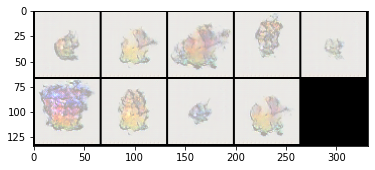

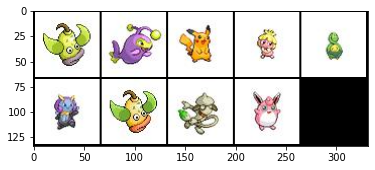

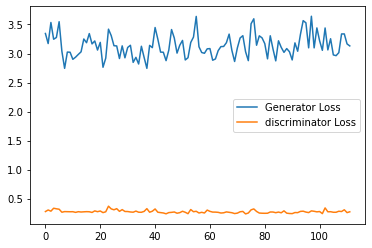

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_2250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2375: Epoch: 15: Generator loss: 3.122024530172348, discriminator loss: 0.282224018573761 mean disc pred on real images: 0.8764879703521729, fake images: 0.12281913310289383


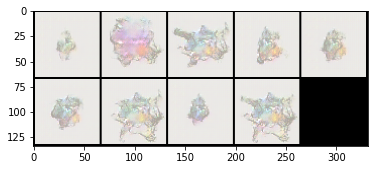

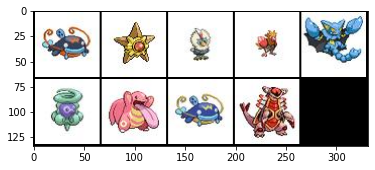

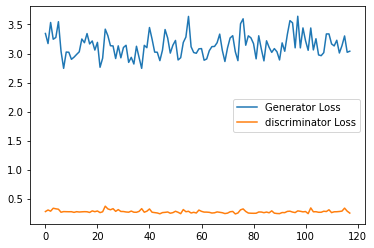

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2500: Epoch: 16: Generator loss: 3.2352914896011353, discriminator loss: 0.28338693487644195 mean disc pred on real images: 0.8746284246444702, fake images: 0.12521515786647797


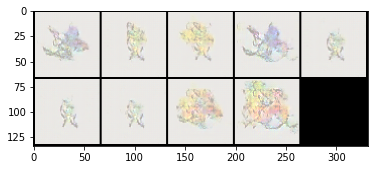

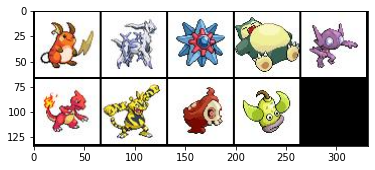

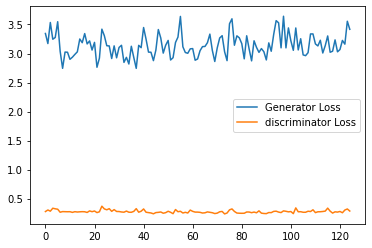

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_2500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2625: Epoch: 16: Generator loss: 3.2277990231513978, discriminator loss: 0.27341112864017486 mean disc pred on real images: 0.8859039545059204, fake images: 0.11492261290550232


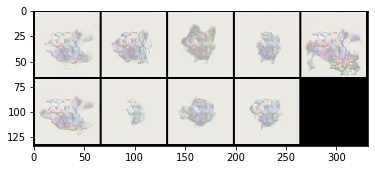

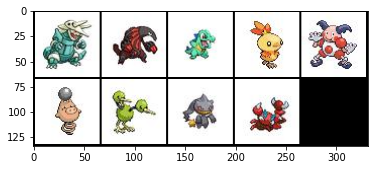

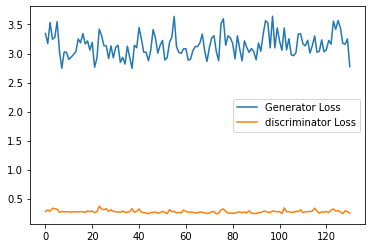

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2750: Epoch: 17: Generator loss: 3.0893601551055907, discriminator loss: 0.26212903928756714 mean disc pred on real images: 0.8848788738250732, fake images: 0.11254584044218063


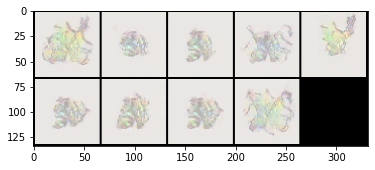

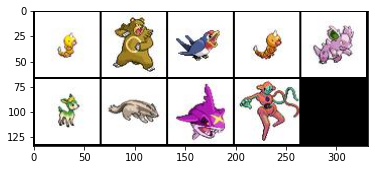

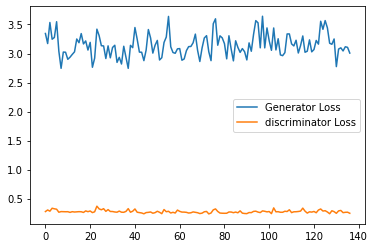

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_2750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2875: Epoch: 18: Generator loss: 3.154428793668747, discriminator loss: 0.2682275913953781 mean disc pred on real images: 0.8856292366981506, fake images: 0.11418751627206802


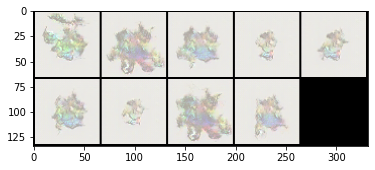

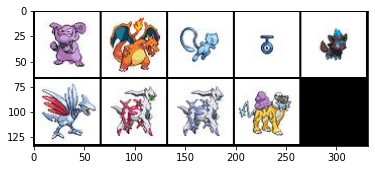

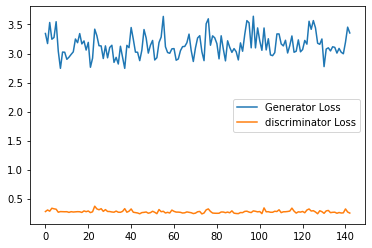

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3000: Epoch: 19: Generator loss: 3.124111309051514, discriminator loss: 0.2647827205657959 mean disc pred on real images: 0.8880665898323059, fake images: 0.11168963462114334


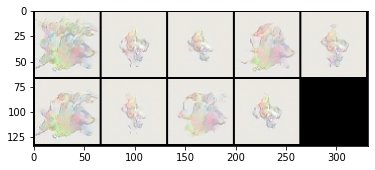

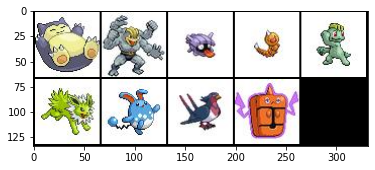

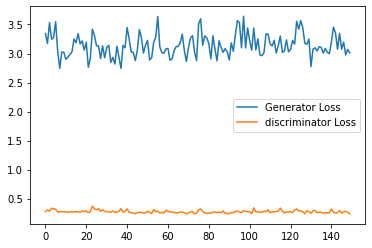

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_3000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa2888d40e0>
Traceback (most recent call last):
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/process.py", line 151, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa2888d40e0>
Traceba

Step 3125: Epoch: 20: Generator loss: 3.1913134965896606, discriminator loss: 0.2676869636774063 mean disc pred on real images: 0.8933718204498291, fake images: 0.10674961656332016


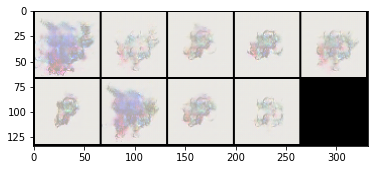

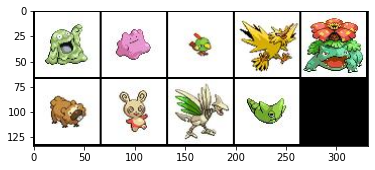

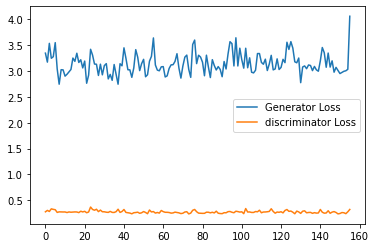

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3250: Epoch: 20: Generator loss: 3.2523356313705443, discriminator loss: 0.2716305893659592 mean disc pred on real images: 0.879490852355957, fake images: 0.11643201857805252


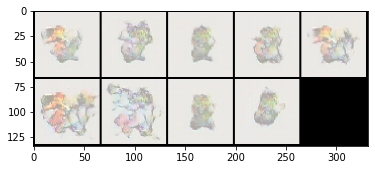

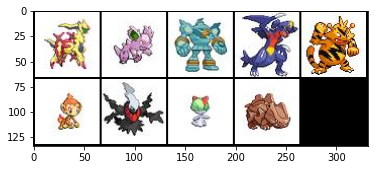

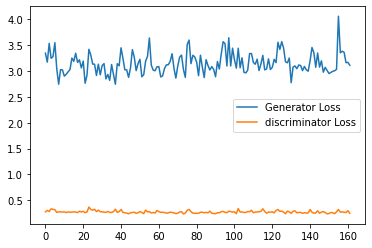

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_3250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3375: Epoch: 21: Generator loss: 3.2639027762413027, discriminator loss: 0.28553999376296996 mean disc pred on real images: 0.8762368559837341, fake images: 0.12349358946084976


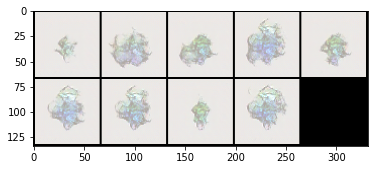

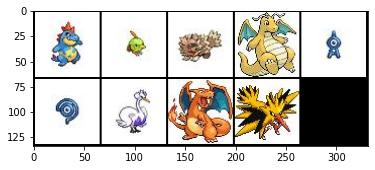

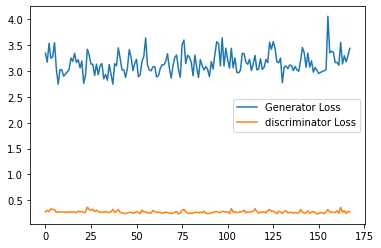

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3500: Epoch: 22: Generator loss: 3.099985301017761, discriminator loss: 0.26373016893863677 mean disc pred on real images: 0.8896639347076416, fake images: 0.1096530333161354


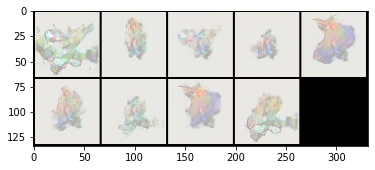

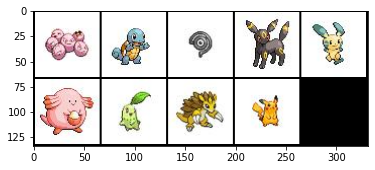

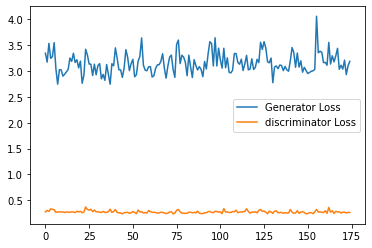

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_3500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3625: Epoch: 23: Generator loss: 3.1212846193313597, discriminator loss: 0.2584904624223709 mean disc pred on real images: 0.8959779739379883, fake images: 0.10564343631267548


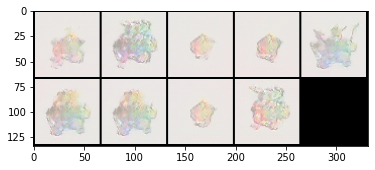

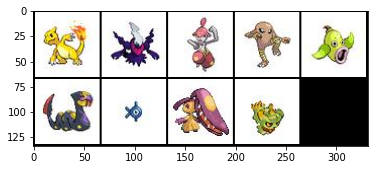

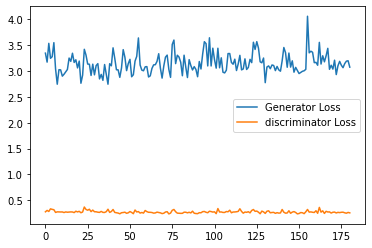

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3750: Epoch: 24: Generator loss: 3.0643589239120486, discriminator loss: 0.24493247544765473 mean disc pred on real images: 0.9044657349586487, fake images: 0.09545806795358658


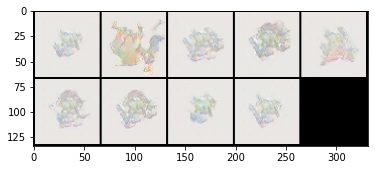

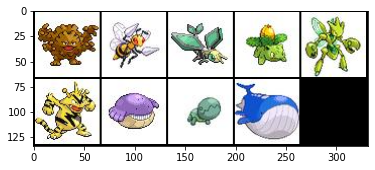

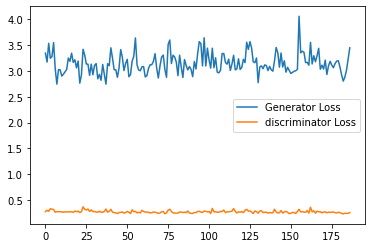

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_3750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3875: Epoch: 25: Generator loss: 3.1804878182411196, discriminator loss: 0.262992863535881 mean disc pred on real images: 0.9031349420547485, fake images: 0.09899081289768219


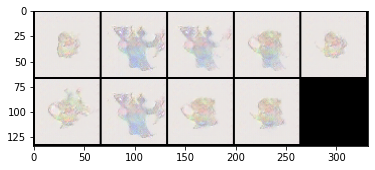

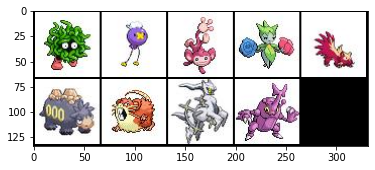

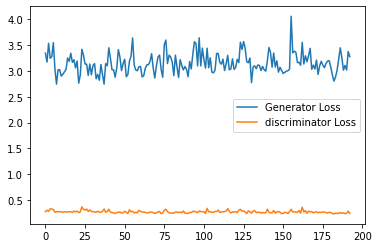

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4000: Epoch: 25: Generator loss: 3.406152269363403, discriminator loss: 0.24109503757953643 mean disc pred on real images: 0.9125636219978333, fake images: 0.08596382290124893


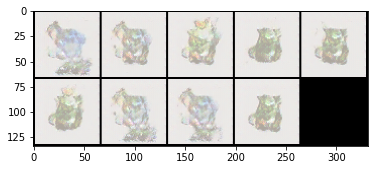

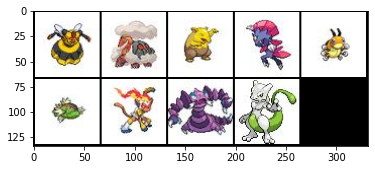

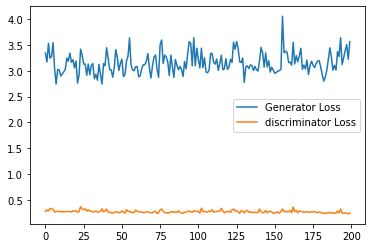

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_4000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4125: Epoch: 26: Generator loss: 3.189947834014893, discriminator loss: 0.23722739064693452 mean disc pred on real images: 0.9175338745117188, fake images: 0.08336251974105835


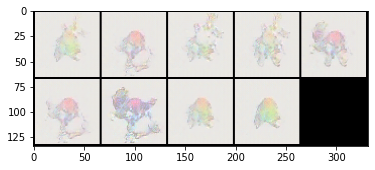

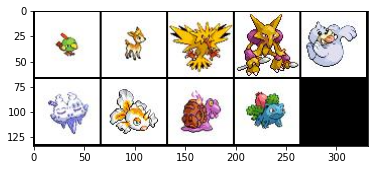

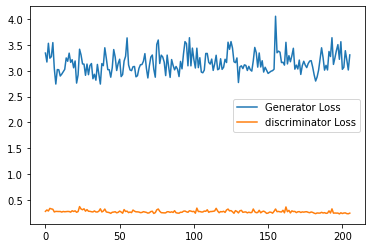

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4250: Epoch: 27: Generator loss: 3.0101741275787353, discriminator loss: 0.23200775015354155 mean disc pred on real images: 0.9172534346580505, fake images: 0.08313941210508347


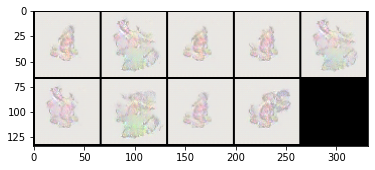

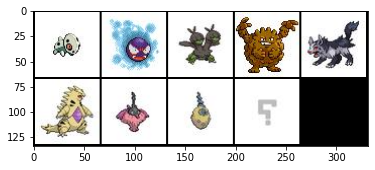

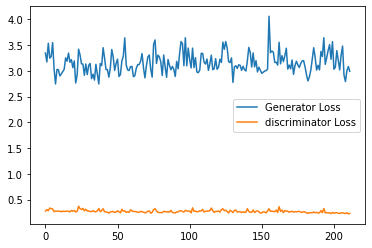

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_4250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4375: Epoch: 28: Generator loss: 3.2030852184295653, discriminator loss: 0.24378764832019806 mean disc pred on real images: 0.9136368036270142, fake images: 0.08743154257535934


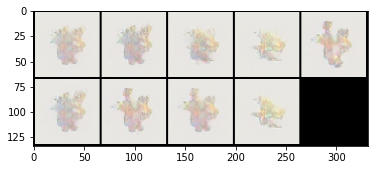

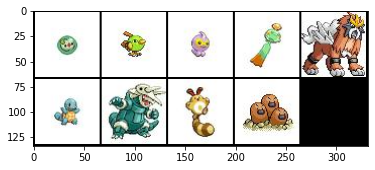

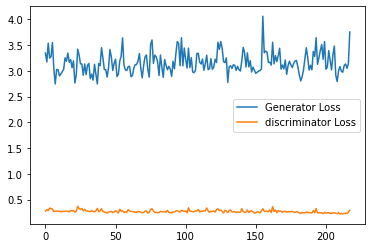

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4500: Epoch: 29: Generator loss: 3.2554950790405273, discriminator loss: 0.23506650257110595 mean disc pred on real images: 0.9207732081413269, fake images: 0.07668446749448776


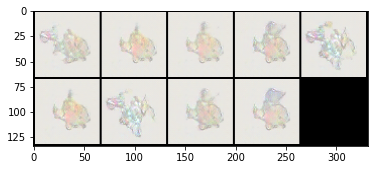

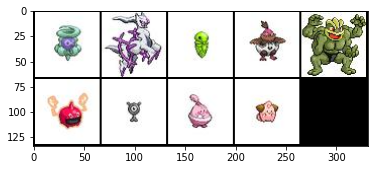

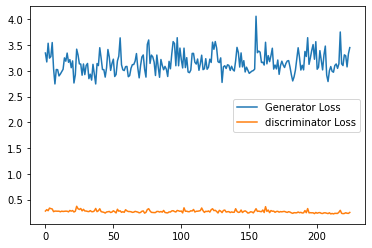

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_4500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4625: Epoch: 29: Generator loss: 3.0687819633483886, discriminator loss: 0.22615536296367644 mean disc pred on real images: 0.9266304969787598, fake images: 0.07445447891950607


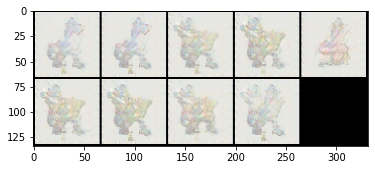

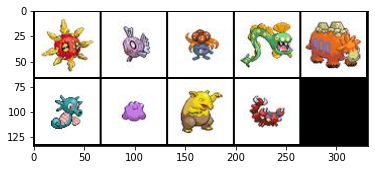

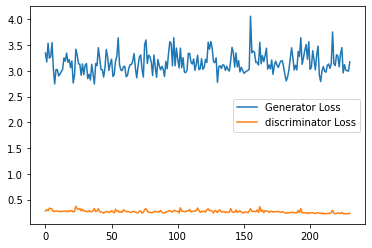

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4750: Epoch: 30: Generator loss: 3.2228993940353394, discriminator loss: 0.24534929871559144 mean disc pred on real images: 0.9088476896286011, fake images: 0.09063197672367096


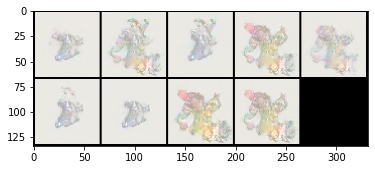

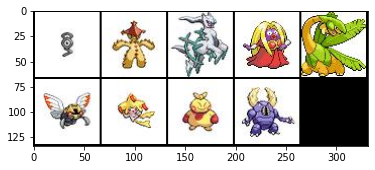

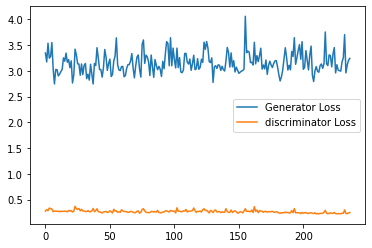

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_4750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4875: Epoch: 31: Generator loss: 3.1363680801391602, discriminator loss: 0.24234394919872285 mean disc pred on real images: 0.9073187708854675, fake images: 0.09317154437303543


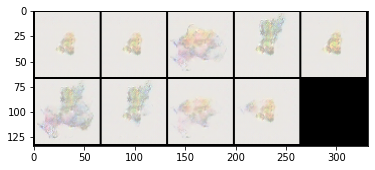

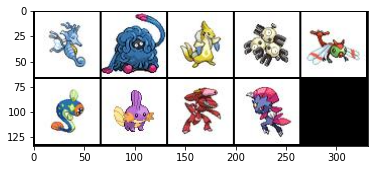

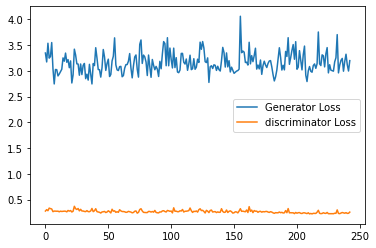

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5000: Epoch: 32: Generator loss: 3.3670413160324095, discriminator loss: 0.25556022191047667 mean disc pred on real images: 0.9047671556472778, fake images: 0.09462402760982513


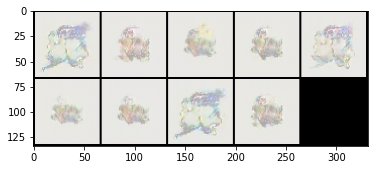

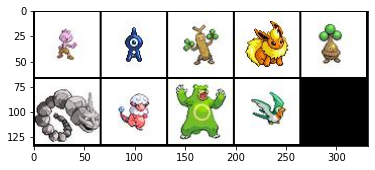

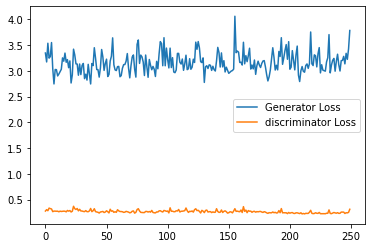

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_5000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5125: Epoch: 33: Generator loss: 3.149058198928833, discriminator loss: 0.23801797246932985 mean disc pred on real images: 0.915555477142334, fake images: 0.08593572676181793


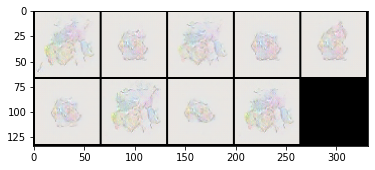

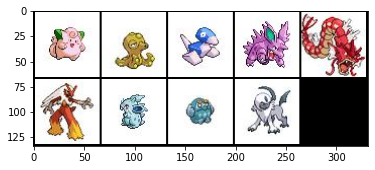

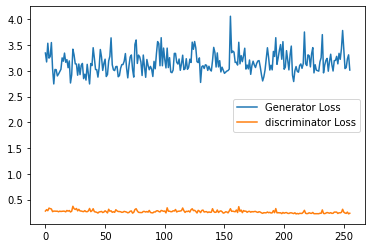

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5250: Epoch: 33: Generator loss: 3.203680528640747, discriminator loss: 0.2481087658405304 mean disc pred on real images: 0.9059134721755981, fake images: 0.09387929737567902


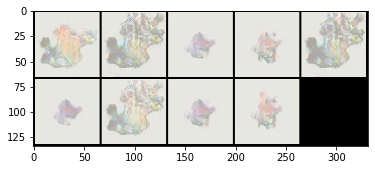

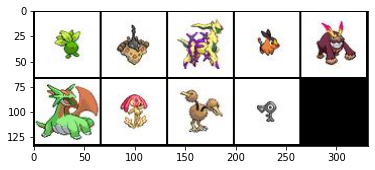

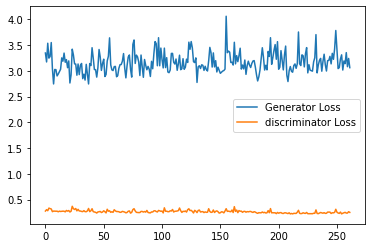

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_5250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5375: Epoch: 34: Generator loss: 3.3086576335430147, discriminator loss: 0.2689963383674622 mean disc pred on real images: 0.8904462456703186, fake images: 0.10830200463533401


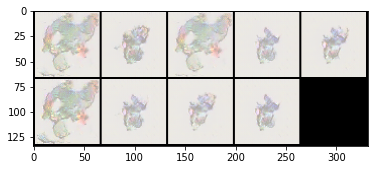

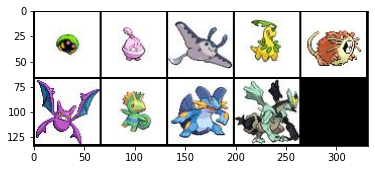

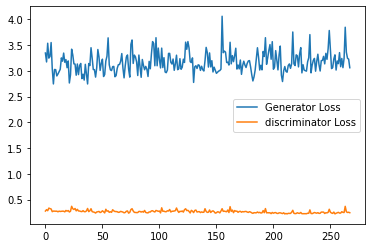

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5500: Epoch: 35: Generator loss: 3.271606515407562, discriminator loss: 0.2572961537837982 mean disc pred on real images: 0.9017549157142639, fake images: 0.0986117422580719


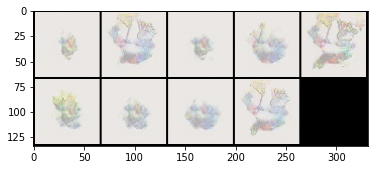

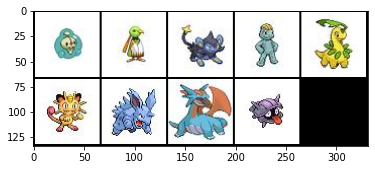

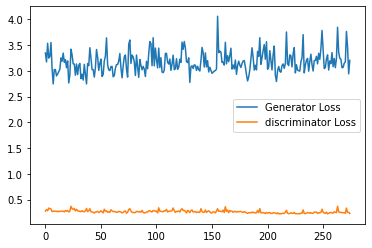

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_5500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5625: Epoch: 36: Generator loss: 3.246060828208923, discriminator loss: 0.2674606417417526 mean disc pred on real images: 0.8884733319282532, fake images: 0.11210622638463974


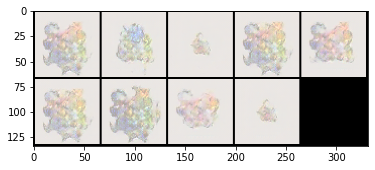

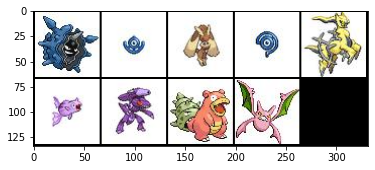

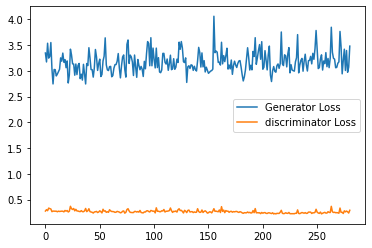

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5750: Epoch: 37: Generator loss: 3.125843635559082, discriminator loss: 0.24562710988521577 mean disc pred on real images: 0.9032912254333496, fake images: 0.09531854838132858


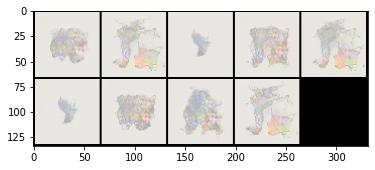

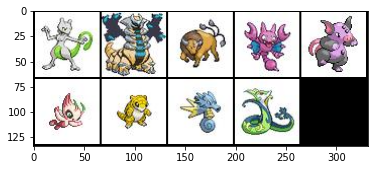

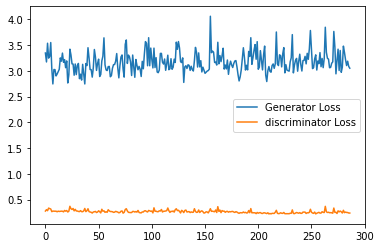

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_5750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5875: Epoch: 37: Generator loss: 3.005799364089966, discriminator loss: 0.23809090971946717 mean disc pred on real images: 0.9112914800643921, fake images: 0.08702439814805984


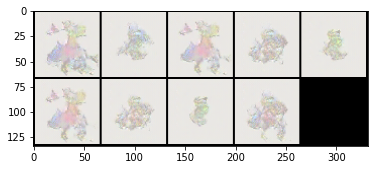

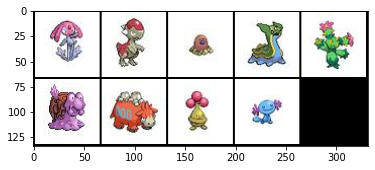

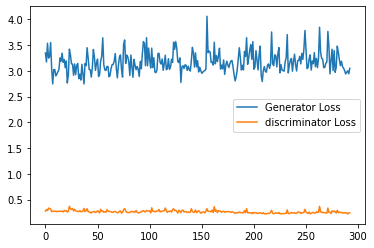

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6000: Epoch: 38: Generator loss: 3.0896089062690737, discriminator loss: 0.24118809628486634 mean disc pred on real images: 0.9127342700958252, fake images: 0.08929766714572906


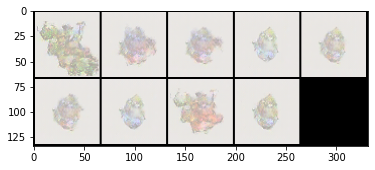

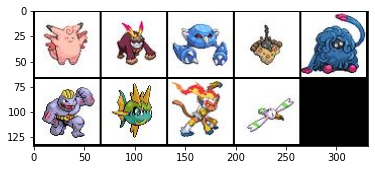

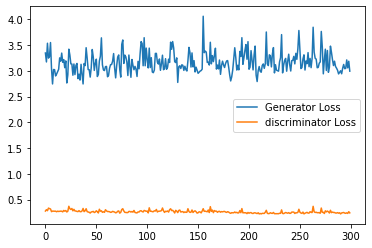

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_6000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6125: Epoch: 39: Generator loss: 3.2719134320020675, discriminator loss: 0.2649123268127441 mean disc pred on real images: 0.8994050621986389, fake images: 0.10265428572893143


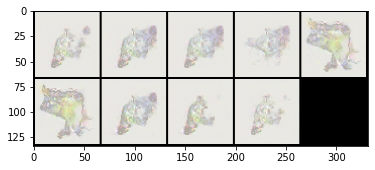

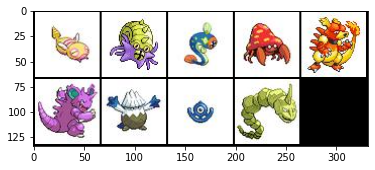

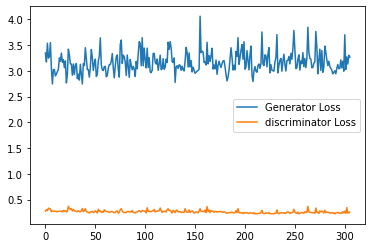

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6250: Epoch: 40: Generator loss: 3.314386951804161, discriminator loss: 0.2509428771734238 mean disc pred on real images: 0.9088886380195618, fake images: 0.0900503545999527


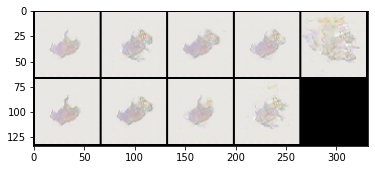

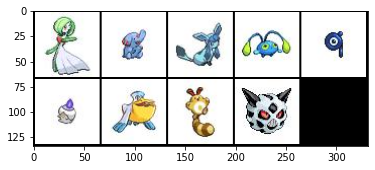

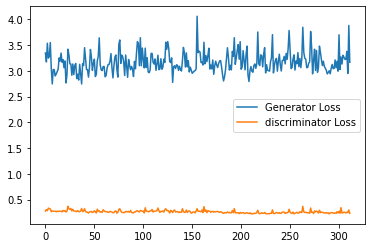

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_6250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6375: Epoch: 41: Generator loss: 3.152758605003357, discriminator loss: 0.2351624982357025 mean disc pred on real images: 0.9127891659736633, fake images: 0.08557596057653427


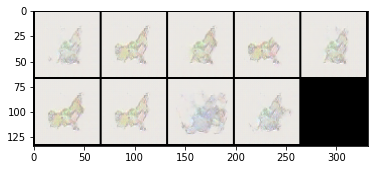

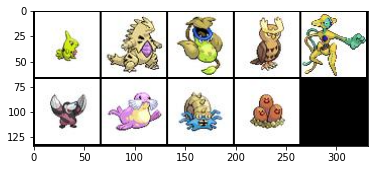

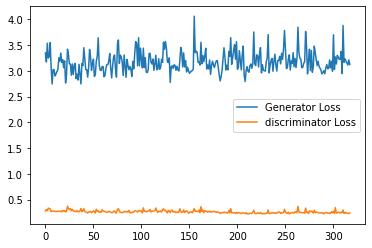

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6500: Epoch: 41: Generator loss: 3.147192330360413, discriminator loss: 0.24019404149055482 mean disc pred on real images: 0.914302408695221, fake images: 0.08504237979650497


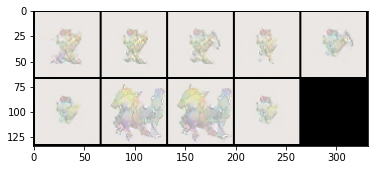

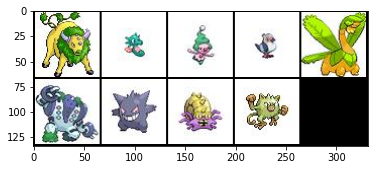

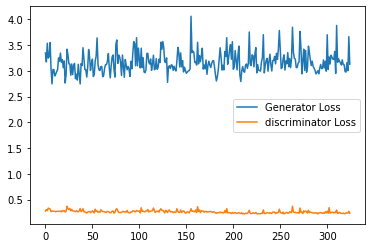

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_6500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6625: Epoch: 42: Generator loss: 3.1665413007736207, discriminator loss: 0.24175098502635955 mean disc pred on real images: 0.9107389450073242, fake images: 0.08862889558076859


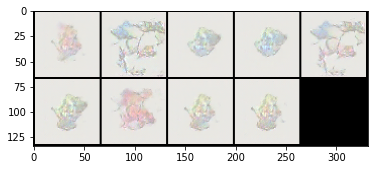

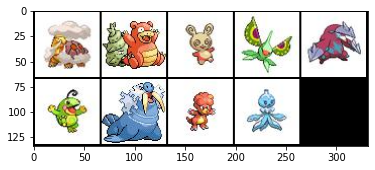

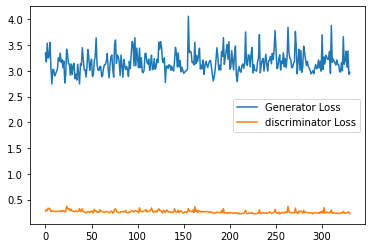

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6750: Epoch: 43: Generator loss: 3.335573981285095, discriminator loss: 0.2675920435190201 mean disc pred on real images: 0.9010588526725769, fake images: 0.10060913860797882


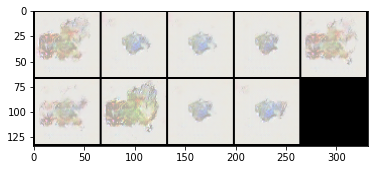

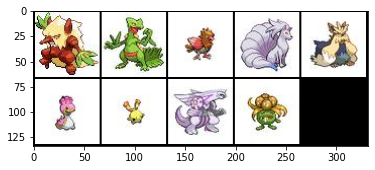

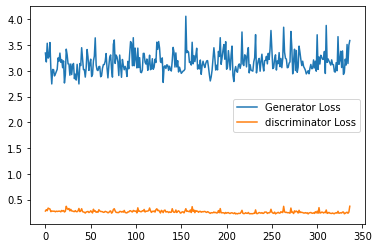

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_6750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6875: Epoch: 44: Generator loss: 3.3354474036693573, discriminator loss: 0.255016884803772 mean disc pred on real images: 0.8971166014671326, fake images: 0.10042472928762436


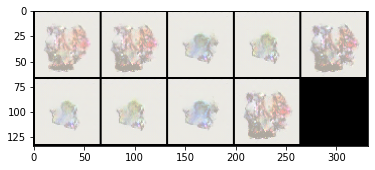

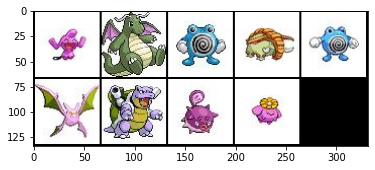

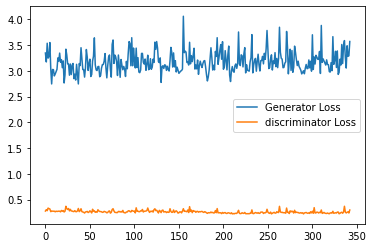

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7000: Epoch: 45: Generator loss: 3.296879892349243, discriminator loss: 0.24785838270187377 mean disc pred on real images: 0.900649905204773, fake images: 0.09607277810573578


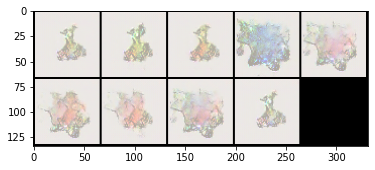

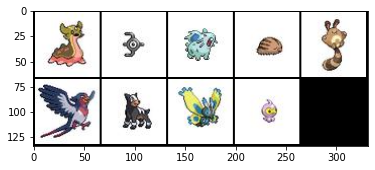

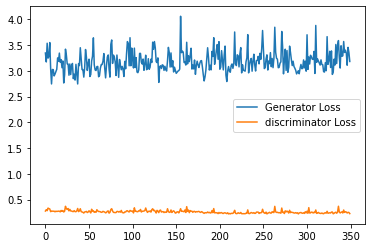

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_7000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7125: Epoch: 45: Generator loss: 3.315519061088562, discriminator loss: 0.25149216449260714 mean disc pred on real images: 0.9012441635131836, fake images: 0.09886790066957474


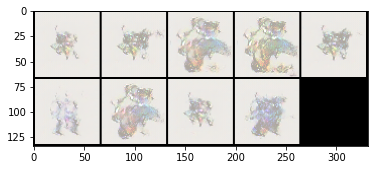

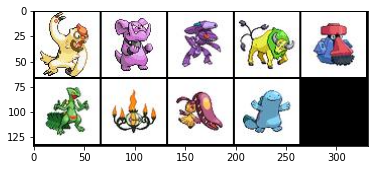

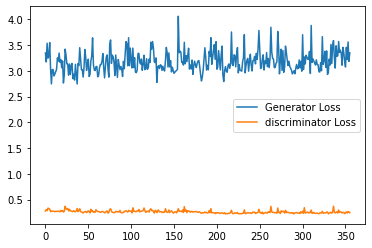

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7250: Epoch: 46: Generator loss: 3.2719411611557008, discriminator loss: 0.25591691601276395 mean disc pred on real images: 0.9020239114761353, fake images: 0.09732287377119064


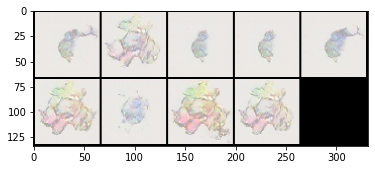

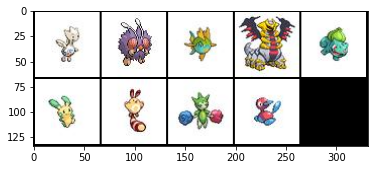

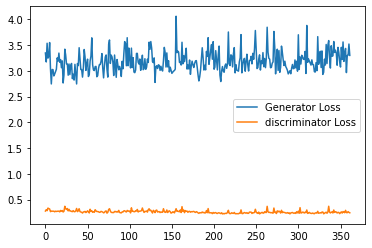

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_7250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7375: Epoch: 47: Generator loss: 3.302687345504761, discriminator loss: 0.2544625165462494 mean disc pred on real images: 0.9022735953330994, fake images: 0.09689616411924362


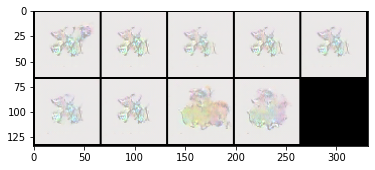

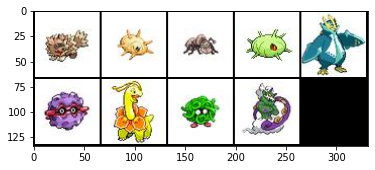

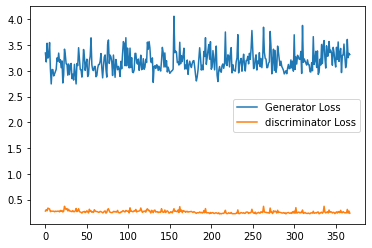

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7500: Epoch: 48: Generator loss: 3.216382640838623, discriminator loss: 0.2317172873020172 mean disc pred on real images: 0.9167553186416626, fake images: 0.08213867992162704


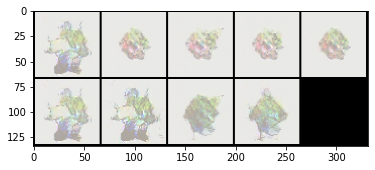

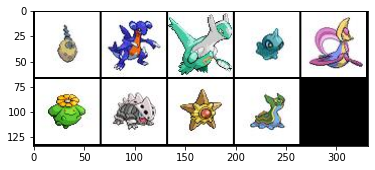

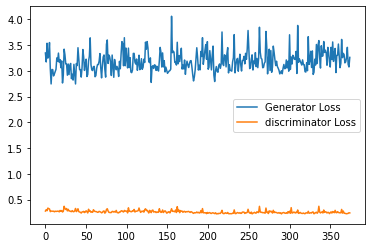

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_7500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7625: Epoch: 49: Generator loss: 3.1657324142456056, discriminator loss: 0.23085809803009033 mean disc pred on real images: 0.9203969240188599, fake images: 0.07896842062473297


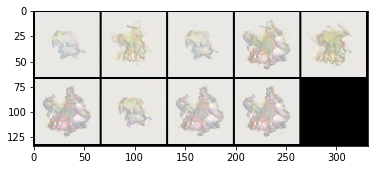

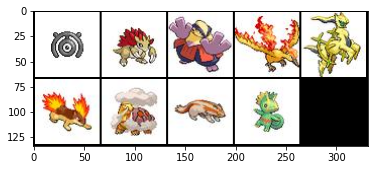

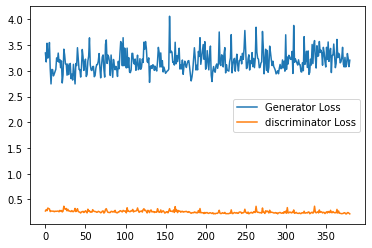

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7750: Epoch: 50: Generator loss: 3.241905508041382, discriminator loss: 0.24764656555652617 mean disc pred on real images: 0.9066616296768188, fake images: 0.09595631062984467


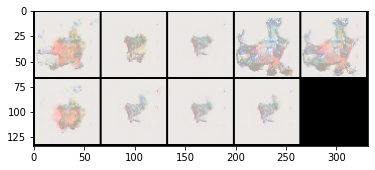

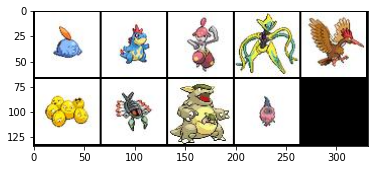

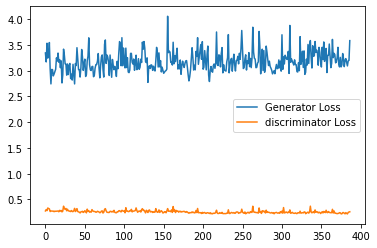

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_7750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7875: Epoch: 50: Generator loss: 3.3837334971427917, discriminator loss: 0.26121858167648315 mean disc pred on real images: 0.8960299491882324, fake images: 0.10130871832370758


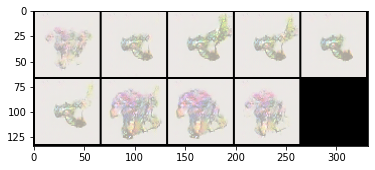

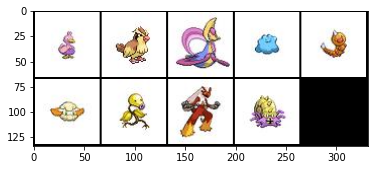

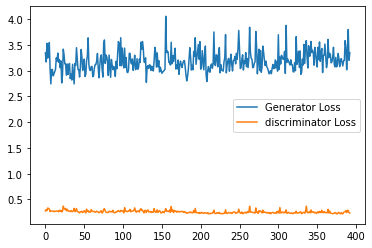

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8000: Epoch: 51: Generator loss: 3.0584458084106445, discriminator loss: 0.23418970358371735 mean disc pred on real images: 0.914828896522522, fake images: 0.08749426156282425


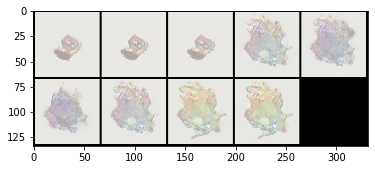

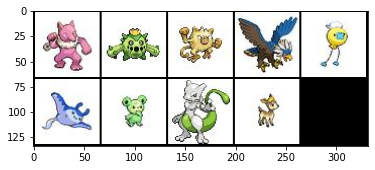

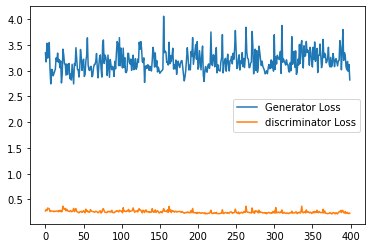

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_8000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8125: Epoch: 52: Generator loss: 3.2842547550201417, discriminator loss: 0.2469154840707779 mean disc pred on real images: 0.907439649105072, fake images: 0.09253066033124924


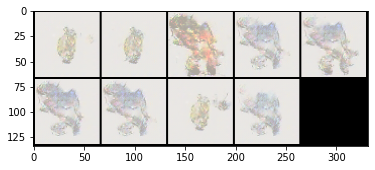

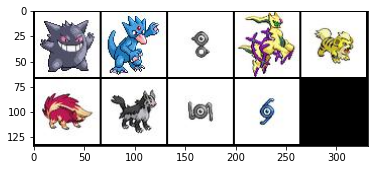

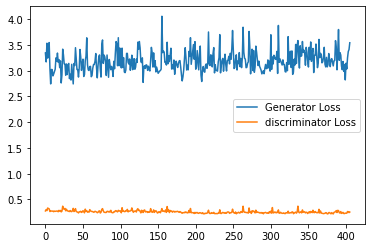

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8250: Epoch: 53: Generator loss: 3.2460873413085936, discriminator loss: 0.2521175208091736 mean disc pred on real images: 0.9066119194030762, fake images: 0.09289205819368362


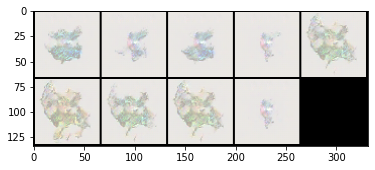

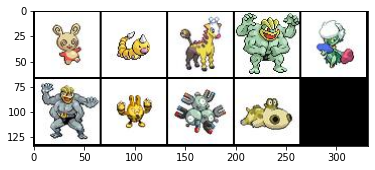

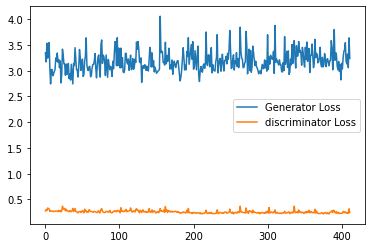

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_8250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8375: Epoch: 54: Generator loss: 3.3568517068624497, discriminator loss: 0.27117294359207156 mean disc pred on real images: 0.8903699517250061, fake images: 0.10733996331691742


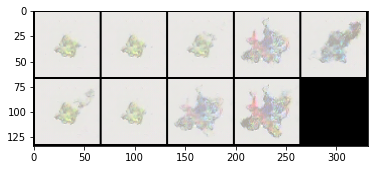

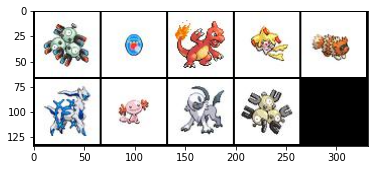

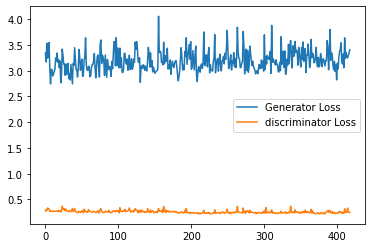

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8500: Epoch: 54: Generator loss: 3.176756166100502, discriminator loss: 0.25049762678146364 mean disc pred on real images: 0.906455397605896, fake images: 0.0965496301651001


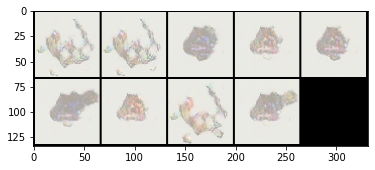

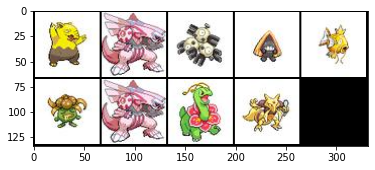

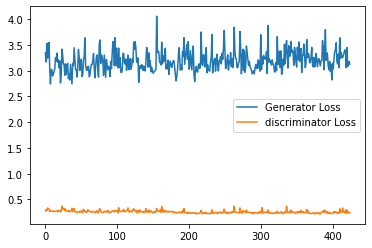

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_8500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8625: Epoch: 55: Generator loss: 3.1561202626228333, discriminator loss: 0.24038796436786652 mean disc pred on real images: 0.9093533754348755, fake images: 0.09029371291399002


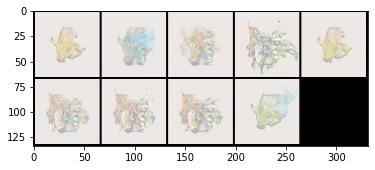

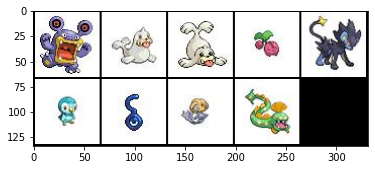

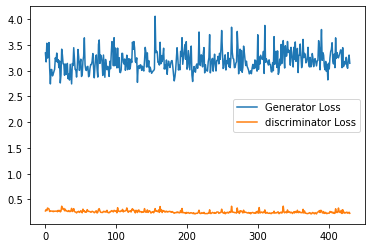

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8750: Epoch: 56: Generator loss: 3.222077154159546, discriminator loss: 0.2460047470331192 mean disc pred on real images: 0.9051090478897095, fake images: 0.093841053545475


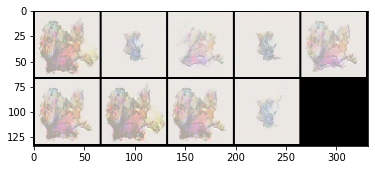

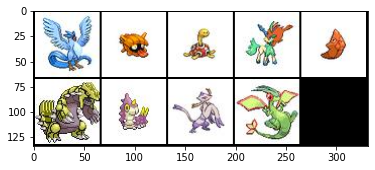

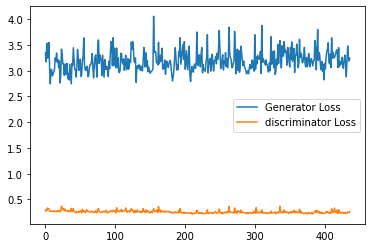

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_8750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8875: Epoch: 57: Generator loss: 3.360517828464508, discriminator loss: 0.2601458456516266 mean disc pred on real images: 0.8960466980934143, fake images: 0.10098925977945328


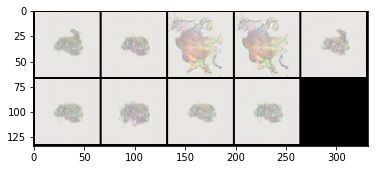

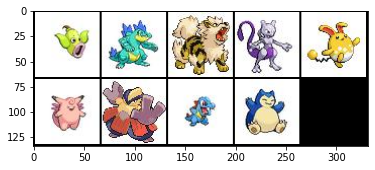

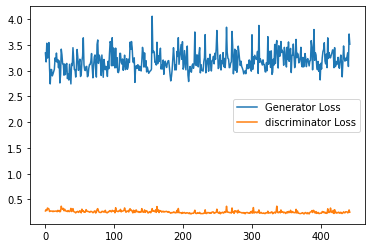

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9000: Epoch: 58: Generator loss: 3.2535653829574587, discriminator loss: 0.24315915501117707 mean disc pred on real images: 0.9127985239028931, fake images: 0.09010376036167145


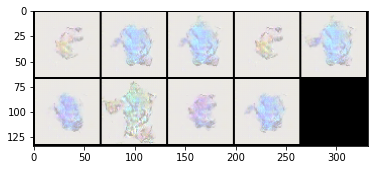

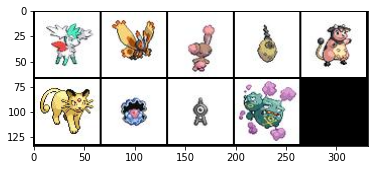

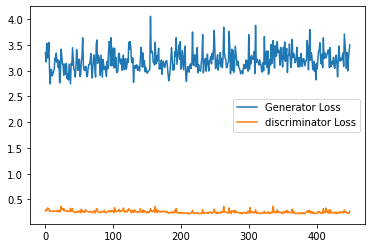

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_9000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9125: Epoch: 58: Generator loss: 3.2936610641479493, discriminator loss: 0.23639116418361664 mean disc pred on real images: 0.909923255443573, fake images: 0.08742722868919373


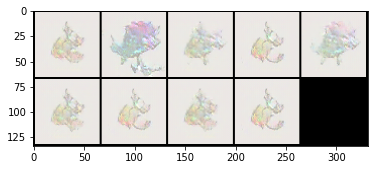

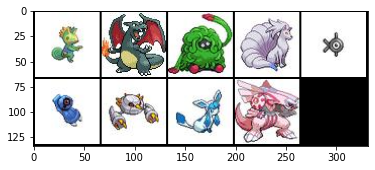

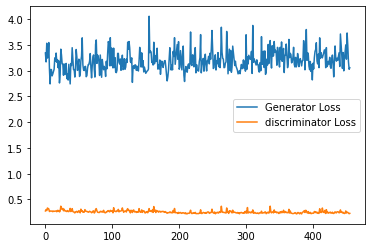

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9250: Epoch: 59: Generator loss: 3.18785432434082, discriminator loss: 0.23038609683513642 mean disc pred on real images: 0.9192839860916138, fake images: 0.07827656716108322


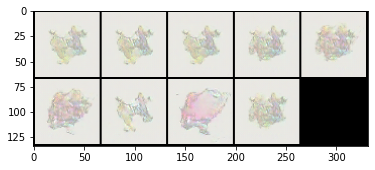

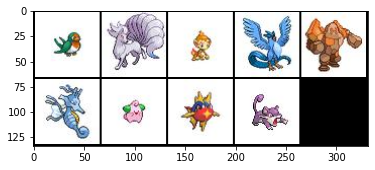

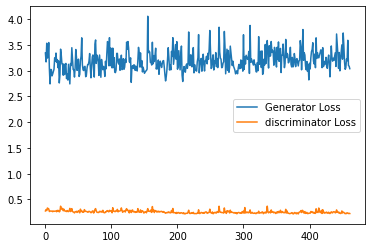

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_9250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9375: Epoch: 60: Generator loss: 3.279829918384552, discriminator loss: 0.2450470850467682 mean disc pred on real images: 0.9172763824462891, fake images: 0.08567138016223907


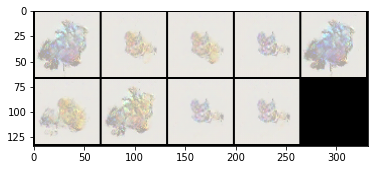

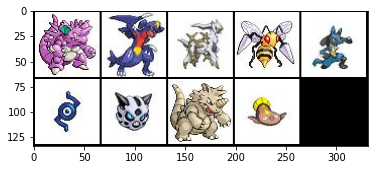

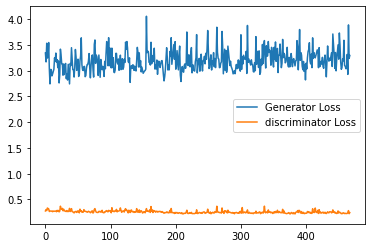

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9500: Epoch: 61: Generator loss: 3.0757640695571897, discriminator loss: 0.23466363692283632 mean disc pred on real images: 0.9171985983848572, fake images: 0.08221924304962158


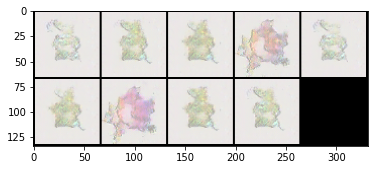

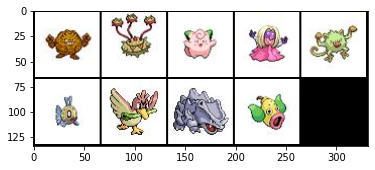

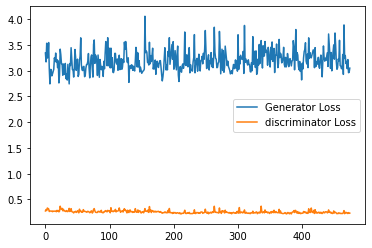

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_9500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9625: Epoch: 62: Generator loss: 3.2614246282577515, discriminator loss: 0.24061896443367004 mean disc pred on real images: 0.9124040603637695, fake images: 0.08747368305921555


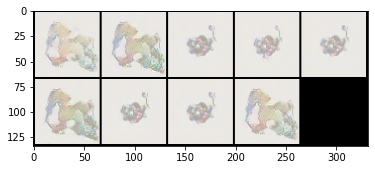

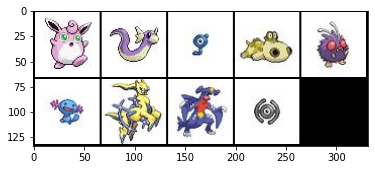

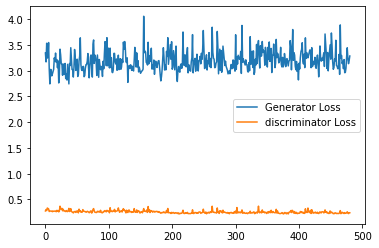

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9750: Epoch: 62: Generator loss: 3.3520099811553954, discriminator loss: 0.24135919916629792 mean disc pred on real images: 0.9159808158874512, fake images: 0.08536213636398315


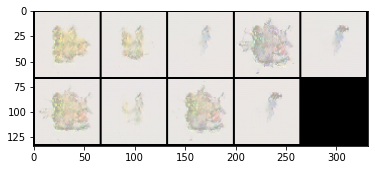

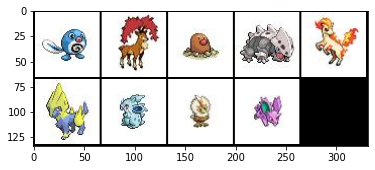

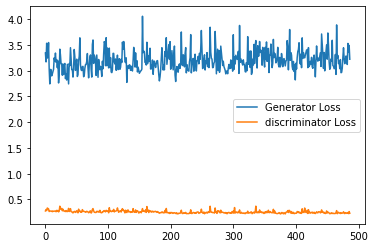

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_9750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9875: Epoch: 63: Generator loss: 3.284605721950531, discriminator loss: 0.24725019907951354 mean disc pred on real images: 0.9070595502853394, fake images: 0.09141401201486588


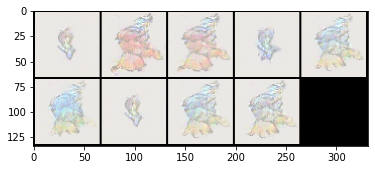

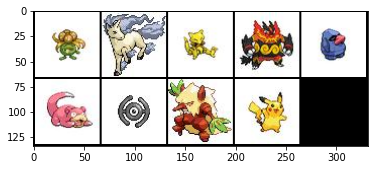

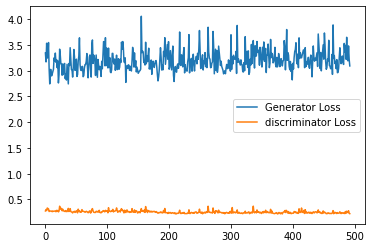

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa2888d40e0>
Traceback (most recent call last):
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/process.py", line 151, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa2888d40e0>
Traceba

Step 10000: Epoch: 64: Generator loss: 3.321869904279709, discriminator loss: 0.24945175886154175 mean disc pred on real images: 0.9166015386581421, fake images: 0.08401776850223541


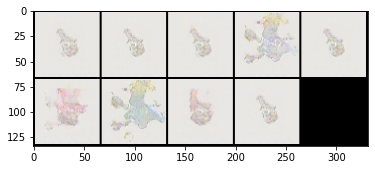

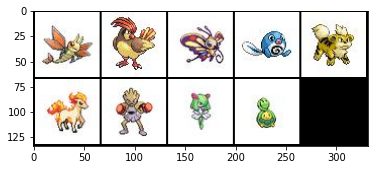

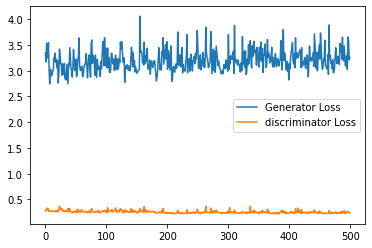

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_10000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10125: Epoch: 65: Generator loss: 3.2134114723205567, discriminator loss: 0.23692675971984864 mean disc pred on real images: 0.9154300689697266, fake images: 0.08345674723386765


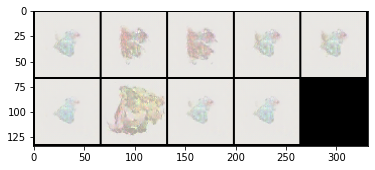

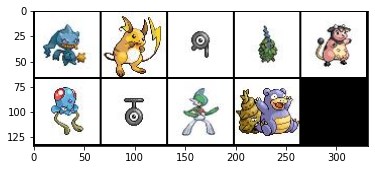

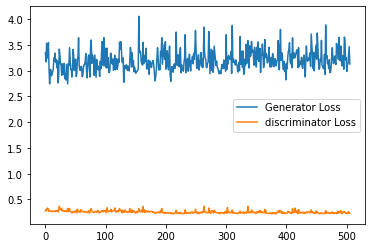

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10250: Epoch: 66: Generator loss: 3.2062226428985596, discriminator loss: 0.23698827910423279 mean disc pred on real images: 0.9104477763175964, fake images: 0.08701112866401672


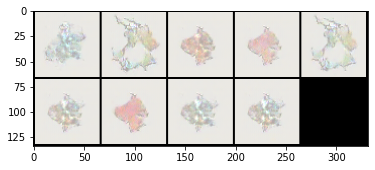

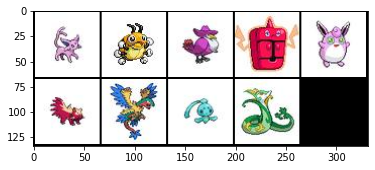

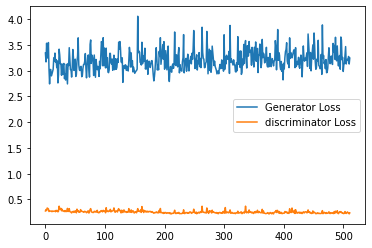

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_10250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10375: Epoch: 66: Generator loss: 3.3632212495803833, discriminator loss: 0.2447573616504669 mean disc pred on real images: 0.9128081202507019, fake images: 0.08831487596035004


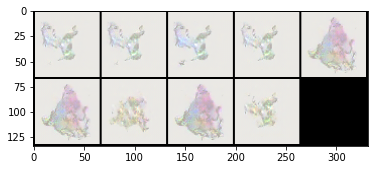

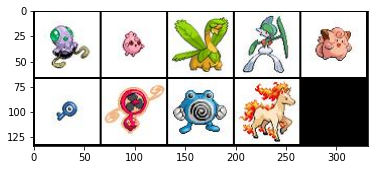

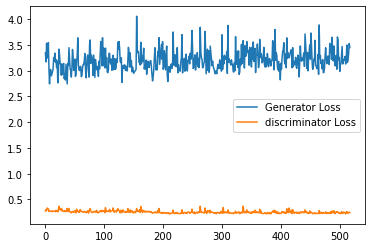

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10500: Epoch: 67: Generator loss: 3.332119170665741, discriminator loss: 0.26004086530208587 mean disc pred on real images: 0.8978855609893799, fake images: 0.10317220538854599


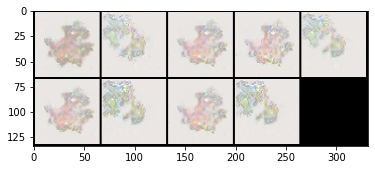

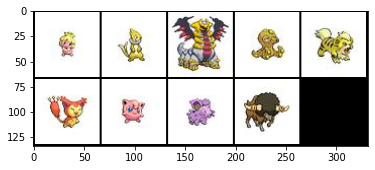

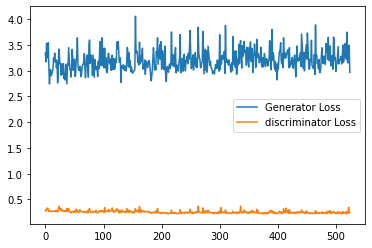

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_10500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10625: Epoch: 68: Generator loss: 3.0856557302474976, discriminator loss: 0.23533265256881714 mean disc pred on real images: 0.9123420119285583, fake images: 0.08585907518863678


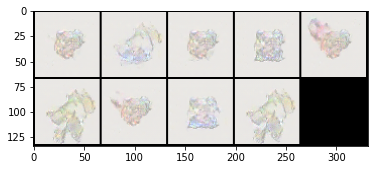

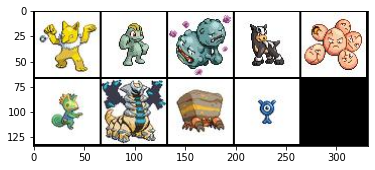

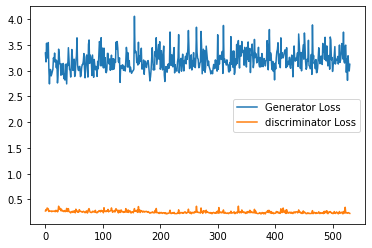

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10750: Epoch: 69: Generator loss: 3.049461664199829, discriminator loss: 0.22670348811149596 mean disc pred on real images: 0.9206768870353699, fake images: 0.07804141938686371


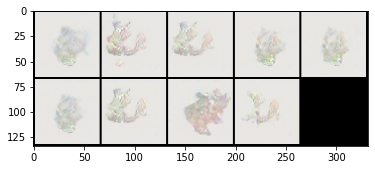

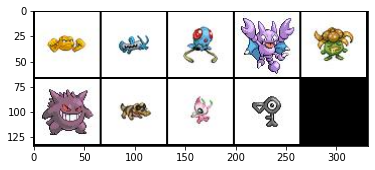

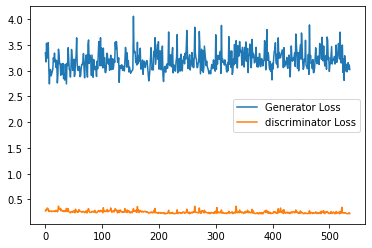

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_10750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10875: Epoch: 70: Generator loss: 3.1250116834640504, discriminator loss: 0.2302800967693329 mean disc pred on real images: 0.9195875525474548, fake images: 0.08018997311592102


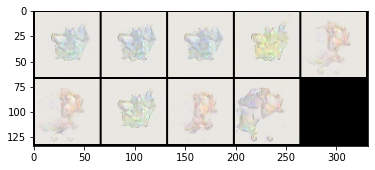

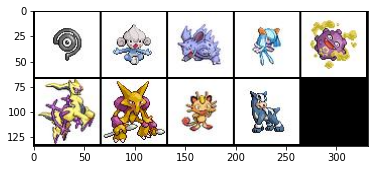

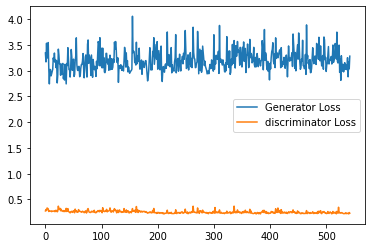

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11000: Epoch: 70: Generator loss: 3.0954845113754272, discriminator loss: 0.22676542985439302 mean disc pred on real images: 0.9210979342460632, fake images: 0.07842041552066803


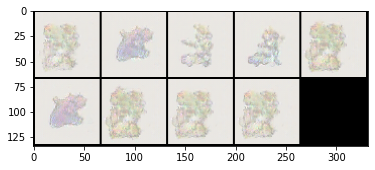

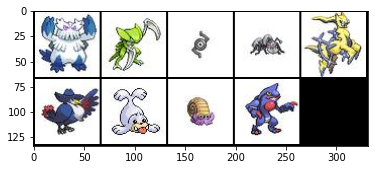

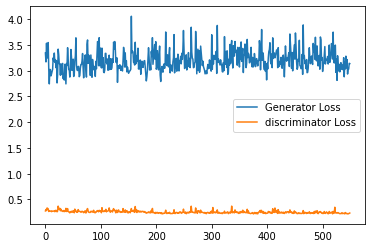

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_11000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11125: Epoch: 71: Generator loss: 3.318095913887024, discriminator loss: 0.23922956502437592 mean disc pred on real images: 0.9179202318191528, fake images: 0.08231189846992493


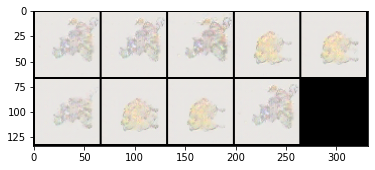

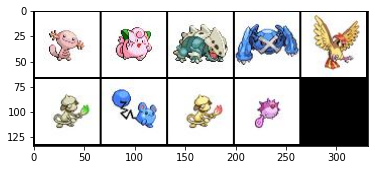

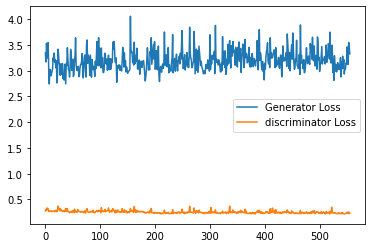

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11250: Epoch: 72: Generator loss: 3.2191825819015505, discriminator loss: 0.24055994403362274 mean disc pred on real images: 0.9121929407119751, fake images: 0.08898643404245377


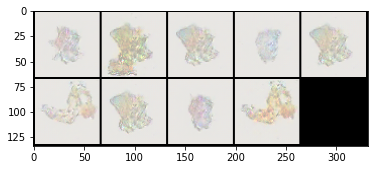

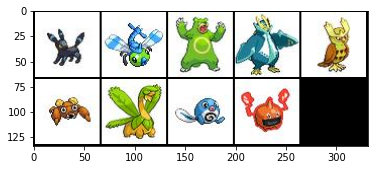

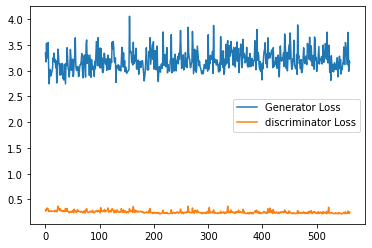

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_11250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11375: Epoch: 73: Generator loss: 3.105284848213196, discriminator loss: 0.24113408958911894 mean disc pred on real images: 0.9116578698158264, fake images: 0.08776507526636124


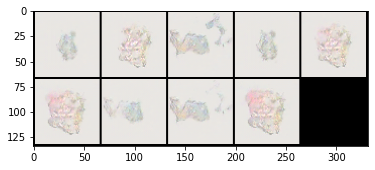

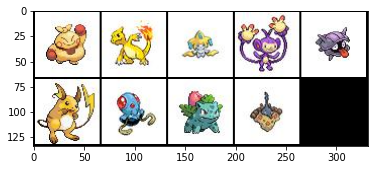

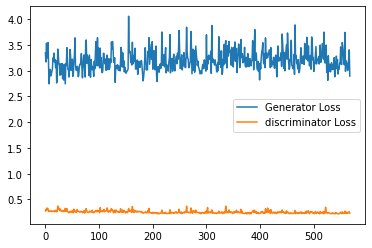

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11500: Epoch: 74: Generator loss: 3.026703974723816, discriminator loss: 0.23395513772964477 mean disc pred on real images: 0.9152602553367615, fake images: 0.08473071455955505


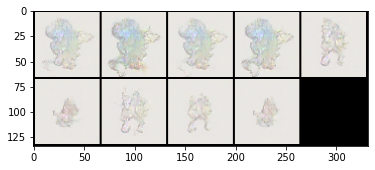

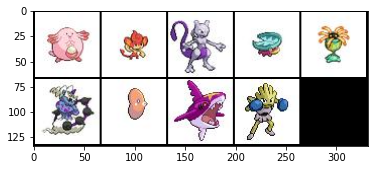

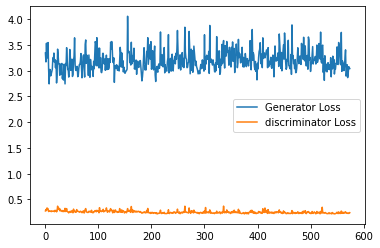

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_11500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11625: Epoch: 75: Generator loss: 3.2106547713279725, discriminator loss: 0.2486981692314148 mean disc pred on real images: 0.9076447486877441, fake images: 0.0929453894495964


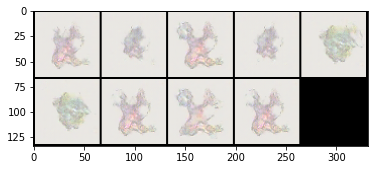

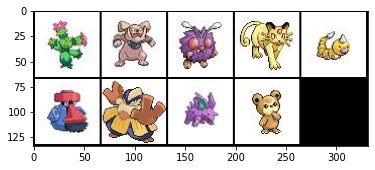

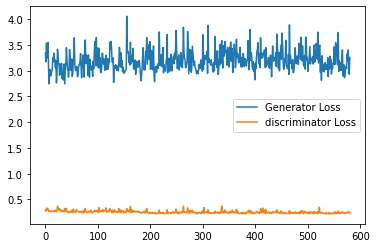

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11750: Epoch: 75: Generator loss: 3.1263072328567505, discriminator loss: 0.23771632754802705 mean disc pred on real images: 0.9155694246292114, fake images: 0.08190680295228958


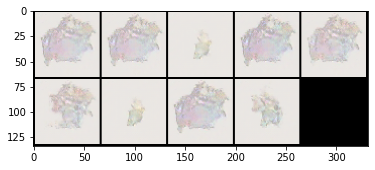

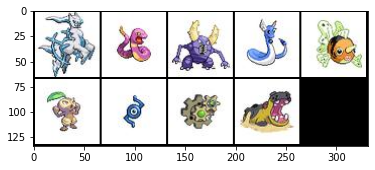

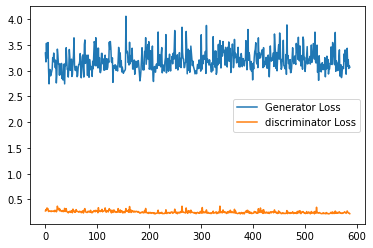

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_11750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11875: Epoch: 76: Generator loss: 3.139096113681793, discriminator loss: 0.25531999254226684 mean disc pred on real images: 0.9025291204452515, fake images: 0.09660954028367996


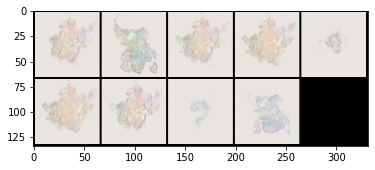

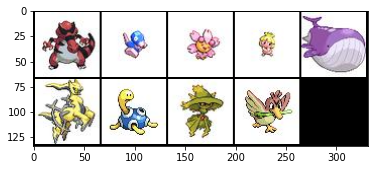

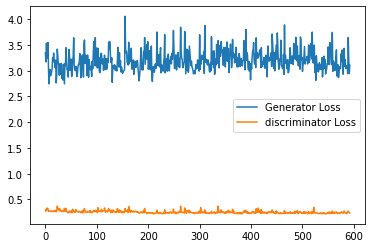

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa2888d40e0>
Traceback (most recent call last):
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/process.py", line 151, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa2888d40e0>
Traceba

Step 12000: Epoch: 77: Generator loss: 3.0294584827423097, discriminator loss: 0.23269697189331054 mean disc pred on real images: 0.9174789190292358, fake images: 0.08270261436700821


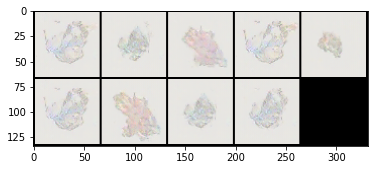

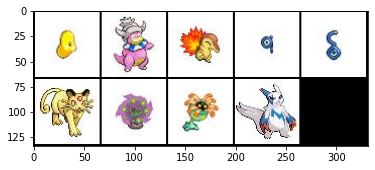

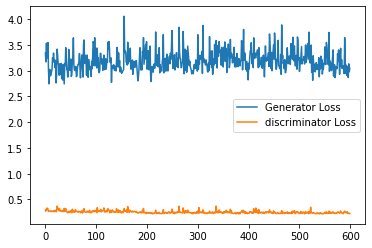

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_12000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12125: Epoch: 78: Generator loss: 3.1383488726615907, discriminator loss: 0.2372675907611847 mean disc pred on real images: 0.9165395498275757, fake images: 0.08382432907819748


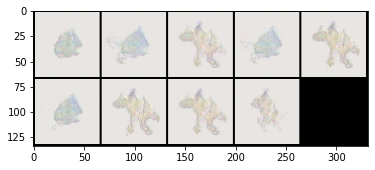

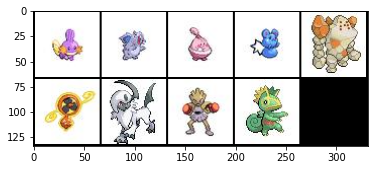

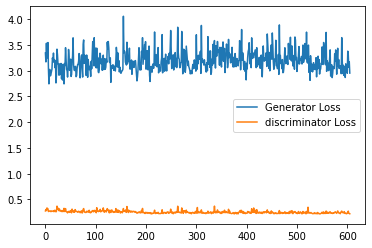

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12250: Epoch: 79: Generator loss: 3.2535280418395995, discriminator loss: 0.23736336970329286 mean disc pred on real images: 0.9123843312263489, fake images: 0.08676167577505112


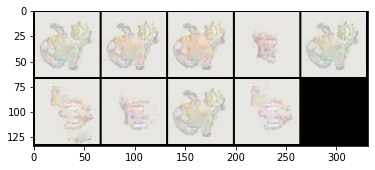

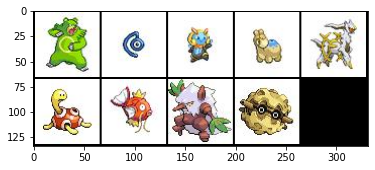

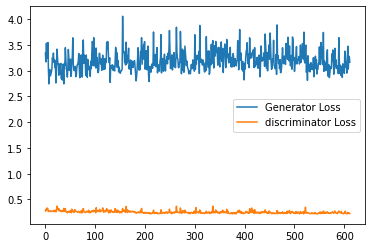

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_12250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12375: Epoch: 79: Generator loss: 3.144567063331604, discriminator loss: 0.23740273821353913 mean disc pred on real images: 0.9132484793663025, fake images: 0.0869019478559494


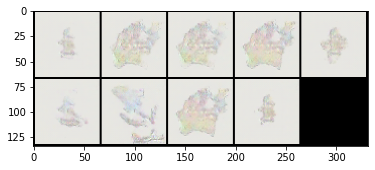

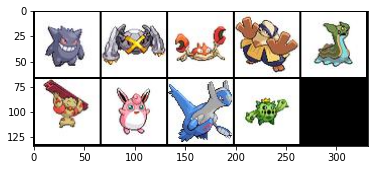

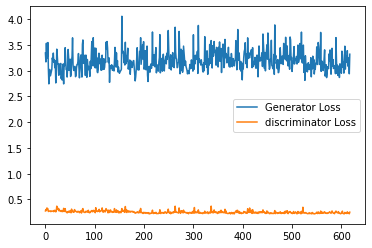

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12500: Epoch: 80: Generator loss: 3.1156209964752195, discriminator loss: 0.232095752120018 mean disc pred on real images: 0.9169002175331116, fake images: 0.08257479965686798


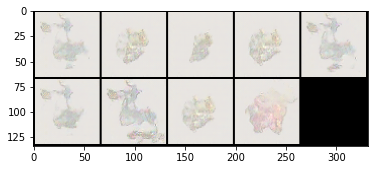

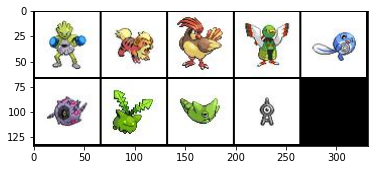

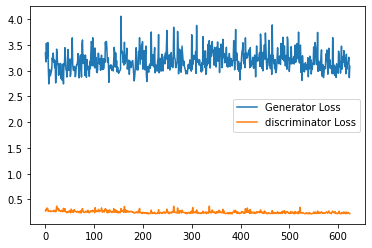

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_12500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


Step 12625: Epoch: 81: Generator loss: 3.0892934494018554, discriminator loss: 0.23151409339904785 mean disc pred on real images: 0.9207202196121216, fake images: 0.0796380341053009


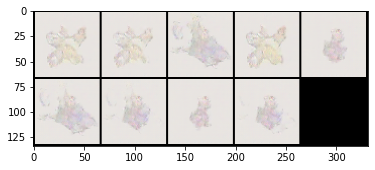

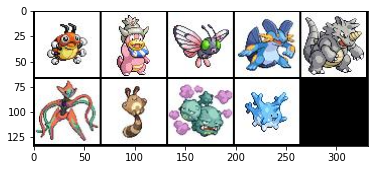

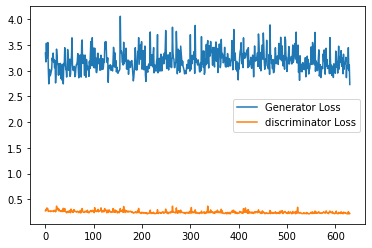

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


Step 12750: Epoch: 82: Generator loss: 3.200576476097107, discriminator loss: 0.23244733643531798 mean disc pred on real images: 0.9189339876174927, fake images: 0.0798843652009964


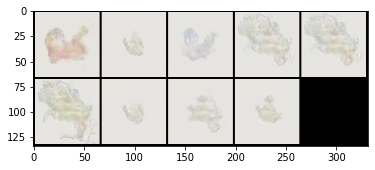

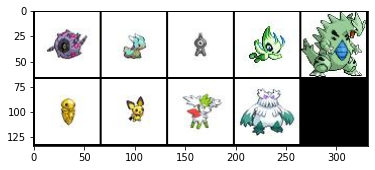

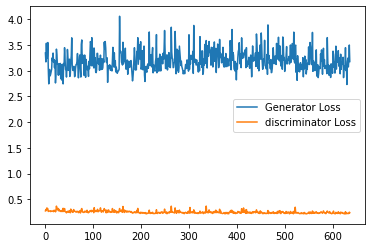

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_12750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12875: Epoch: 83: Generator loss: 3.19468070936203, discriminator loss: 0.2449768624305725 mean disc pred on real images: 0.9177325963973999, fake images: 0.08592130243778229


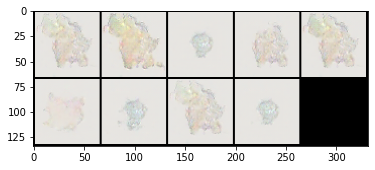

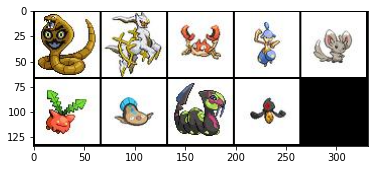

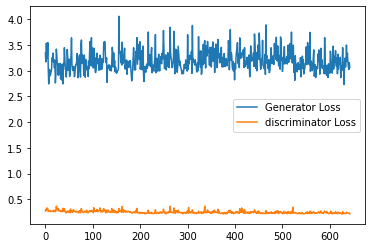

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13000: Epoch: 83: Generator loss: 3.116970006942749, discriminator loss: 0.23301984000205994 mean disc pred on real images: 0.9163557887077332, fake images: 0.08208771795034409


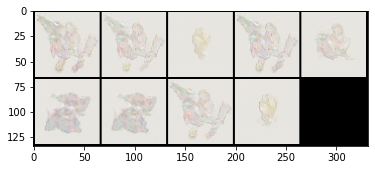

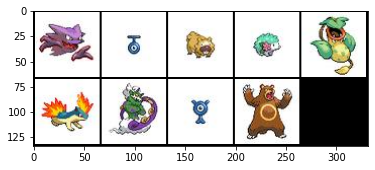

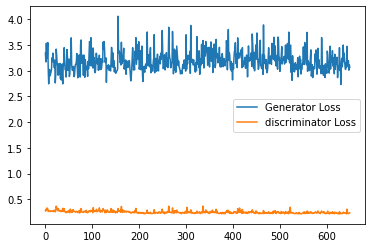

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_13000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13125: Epoch: 84: Generator loss: 3.1551961245536804, discriminator loss: 0.2389532994031906 mean disc pred on real images: 0.9148374795913696, fake images: 0.08396867662668228


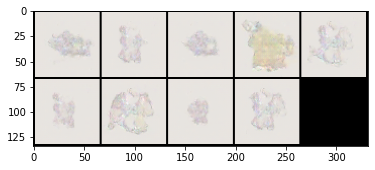

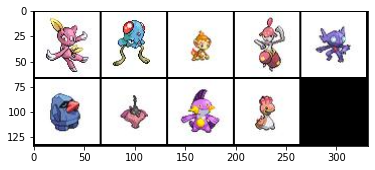

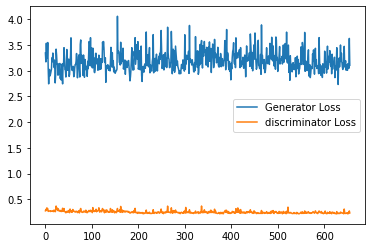

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


Step 13250: Epoch: 85: Generator loss: 3.13282701921463, discriminator loss: 0.23761274302005767 mean disc pred on real images: 0.914230465888977, fake images: 0.08556963503360748


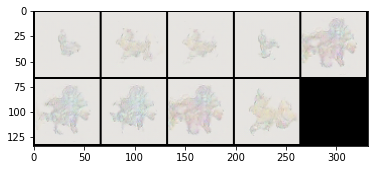

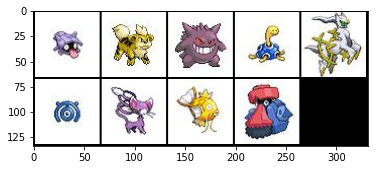

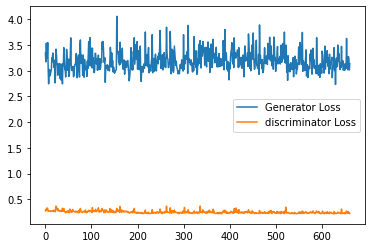

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_13250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


Step 13375: Epoch: 86: Generator loss: 3.373424195766449, discriminator loss: 0.24188830268383027 mean disc pred on real images: 0.9147979617118835, fake images: 0.08482315391302109


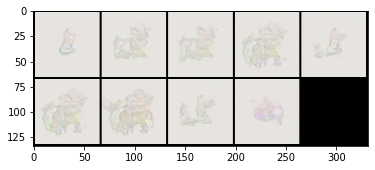

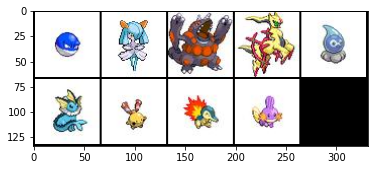

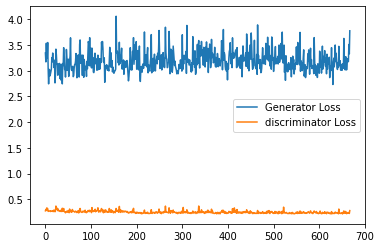

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


Step 13500: Epoch: 87: Generator loss: 3.1756554393768313, discriminator loss: 0.23836605036258698 mean disc pred on real images: 0.9145683646202087, fake images: 0.08357798308134079


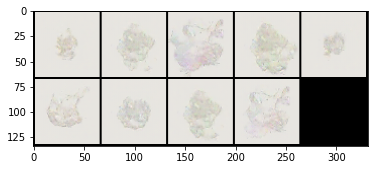

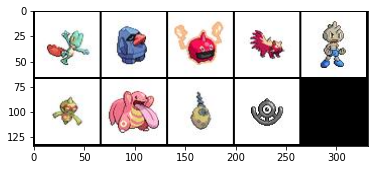

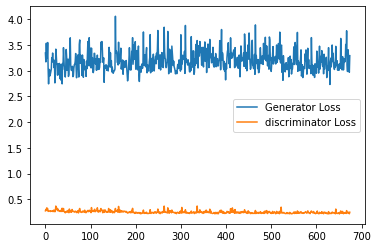

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_13500.pt !
Step 13625: Epoch: 87: Generator loss: 3.3514558711051943, discriminator loss: 0.25919332504272463 mean disc pred on real images: 0.9018349051475525, fake images: 0.09820984303951263


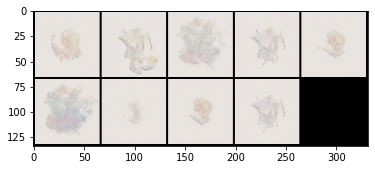

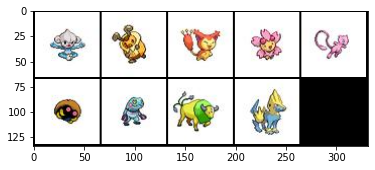

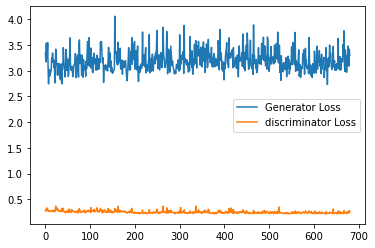

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


Step 13750: Epoch: 88: Generator loss: 3.2920513286590576, discriminator loss: 0.23569763326644896 mean disc pred on real images: 0.9190621376037598, fake images: 0.0821850523352623


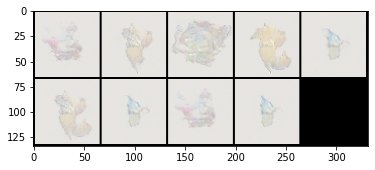

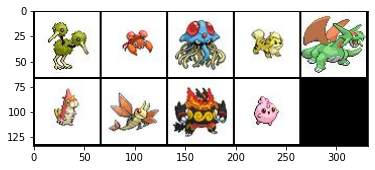

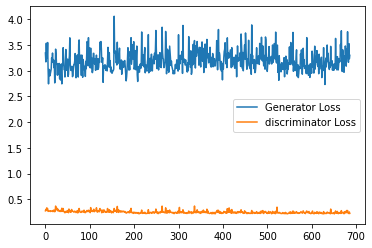

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_13750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13875: Epoch: 89: Generator loss: 3.124928126335144, discriminator loss: 0.2335830993652344 mean disc pred on real images: 0.9211646914482117, fake images: 0.07950647920370102


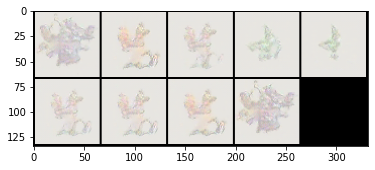

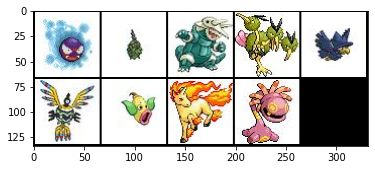

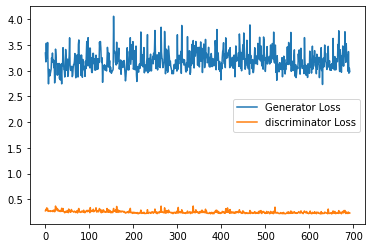

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa2888d40e0>
Traceback (most recent call last):
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/process.py", line 151, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa2888d40e0>
Traceba

Step 14000: Epoch: 90: Generator loss: 3.0853901104927064, discriminator loss: 0.22811276042461395 mean disc pred on real images: 0.923314094543457, fake images: 0.07745903730392456


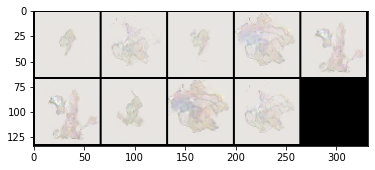

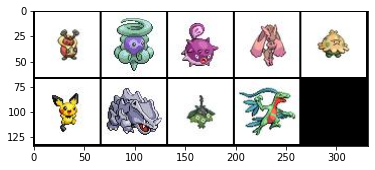

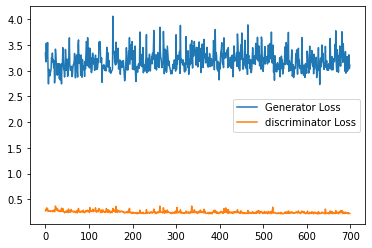

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_14000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


Step 14125: Epoch: 91: Generator loss: 3.0684922952651976, discriminator loss: 0.2335022290945053 mean disc pred on real images: 0.9164028763771057, fake images: 0.08378242701292038


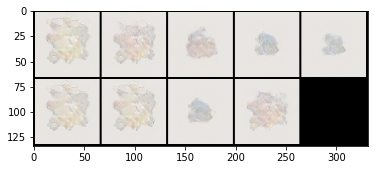

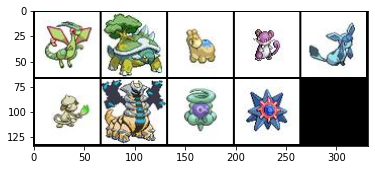

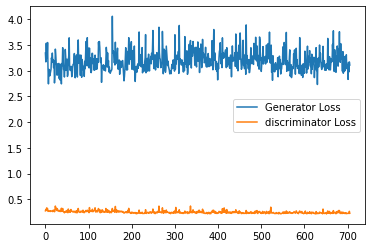

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14250: Epoch: 91: Generator loss: 3.1210041570663454, discriminator loss: 0.23525845515727997 mean disc pred on real images: 0.9185056686401367, fake images: 0.08052751421928406


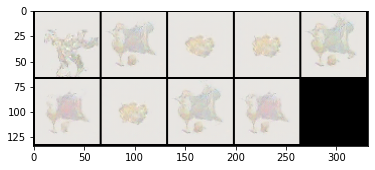

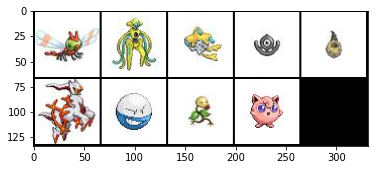

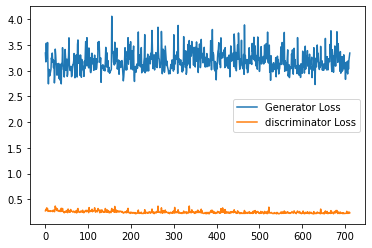

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_14250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14375: Epoch: 92: Generator loss: 3.112138837337494, discriminator loss: 0.24258826553821564 mean disc pred on real images: 0.9159344434738159, fake images: 0.08578232675790787


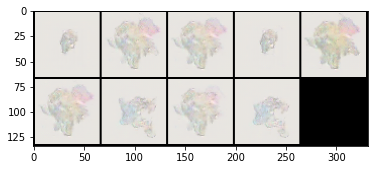

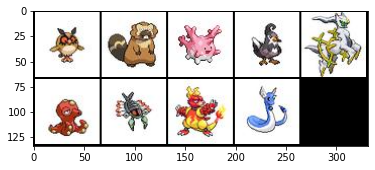

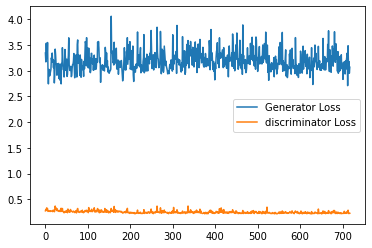

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14500: Epoch: 93: Generator loss: 3.164514693260193, discriminator loss: 0.24177283704280852 mean disc pred on real images: 0.9092176556587219, fake images: 0.0894131138920784


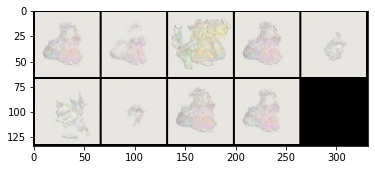

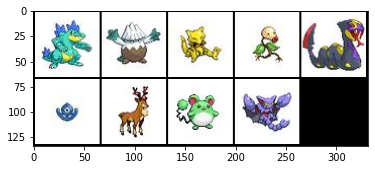

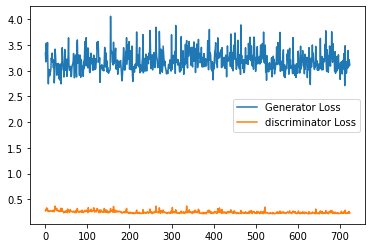

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_14500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14625: Epoch: 94: Generator loss: 3.162198863506317, discriminator loss: 0.24298916935920714 mean disc pred on real images: 0.9130250215530396, fake images: 0.08654281497001648


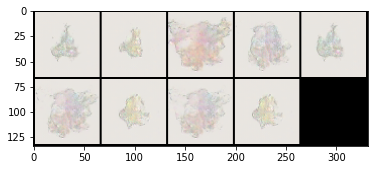

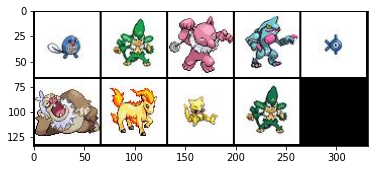

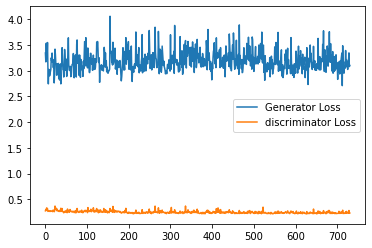

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


Step 14750: Epoch: 95: Generator loss: 2.987386490821838, discriminator loss: 0.23050943028926849 mean disc pred on real images: 0.9195562601089478, fake images: 0.08066457509994507


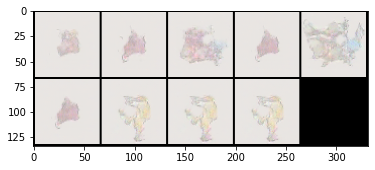

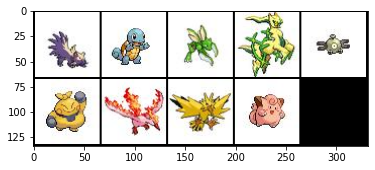

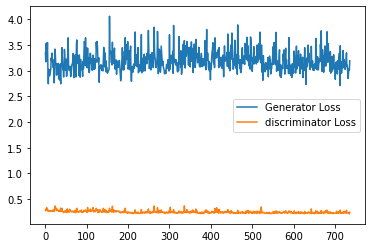

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_14750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14875: Epoch: 95: Generator loss: 3.0756390829086304, discriminator loss: 0.22740330398082734 mean disc pred on real images: 0.9236836433410645, fake images: 0.07490025460720062


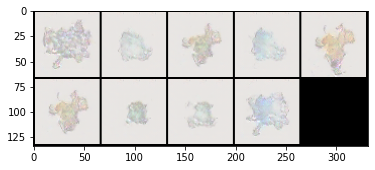

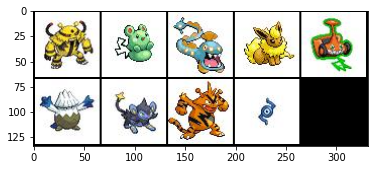

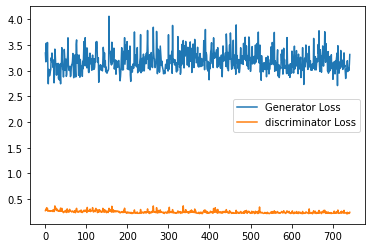

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15000: Epoch: 96: Generator loss: 3.098107180595398, discriminator loss: 0.22210538625717163 mean disc pred on real images: 0.9276432394981384, fake images: 0.0724179819226265


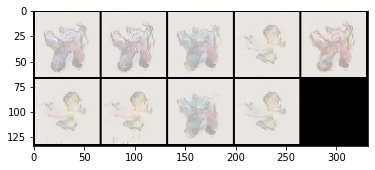

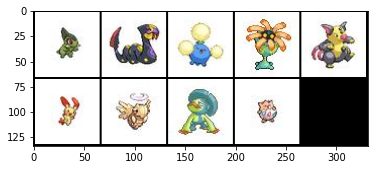

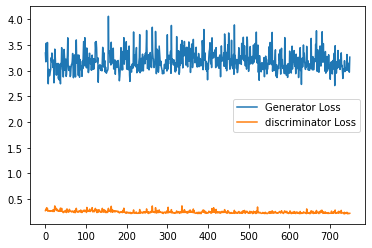

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_15000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15125: Epoch: 97: Generator loss: 3.192745546340942, discriminator loss: 0.2346344155073166 mean disc pred on real images: 0.9197007417678833, fake images: 0.08049041777849197


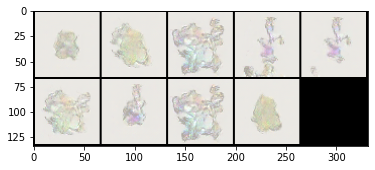

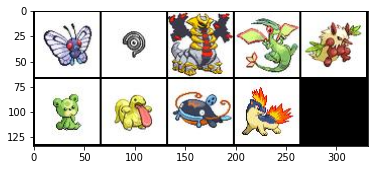

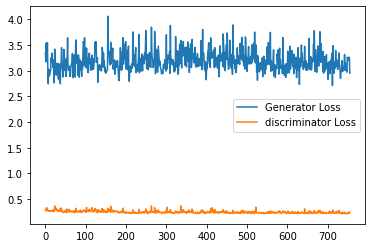

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15250: Epoch: 98: Generator loss: 3.076240704536438, discriminator loss: 0.23451485204696657 mean disc pred on real images: 0.9152224063873291, fake images: 0.08426649868488312


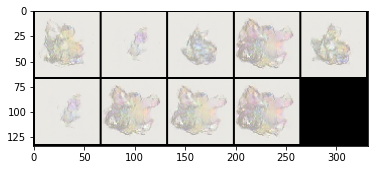

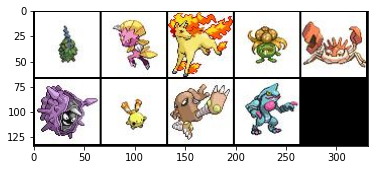

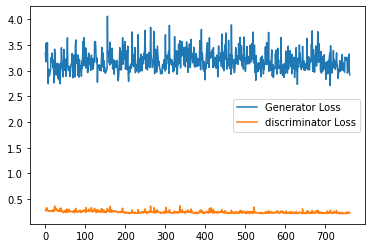

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_15250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa2888d40e0>
Traceback (most recent call last):
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/process.py", line 151, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa2888d40e0>
Traceback (most recent call last):
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
 

Step 15375: Epoch: 99: Generator loss: 3.214927867412567, discriminator loss: 0.24307705116271972 mean disc pred on real images: 0.91230708360672, fake images: 0.0875982940196991


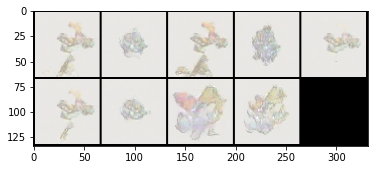

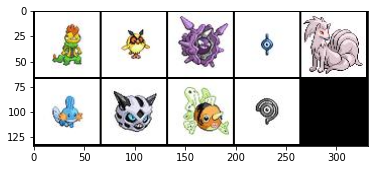

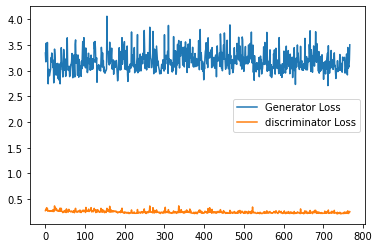

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15500: Epoch: 100: Generator loss: 3.161404137611389, discriminator loss: 0.2560406304597855 mean disc pred on real images: 0.9053266644477844, fake images: 0.09830158948898315


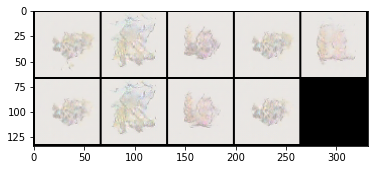

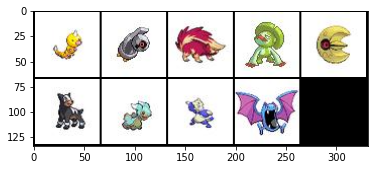

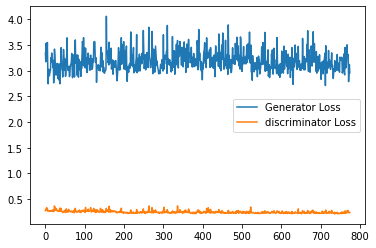

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_15500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15625: Epoch: 100: Generator loss: 3.2276269903182984, discriminator loss: 0.2390685827732086 mean disc pred on real images: 0.9136022329330444, fake images: 0.08393912017345428


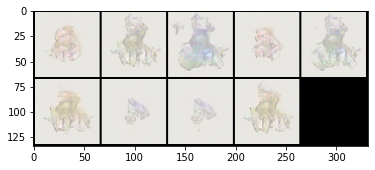

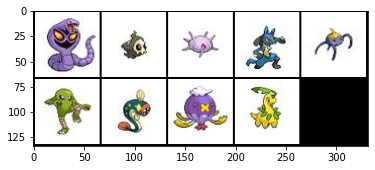

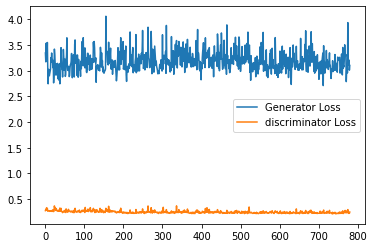

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15750: Epoch: 101: Generator loss: 3.1800641555786133, discriminator loss: 0.23205654120445252 mean disc pred on real images: 0.9183213710784912, fake images: 0.08064699918031693


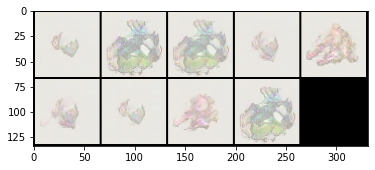

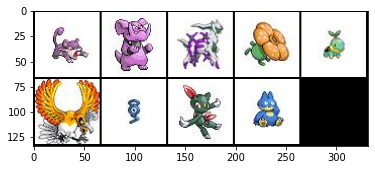

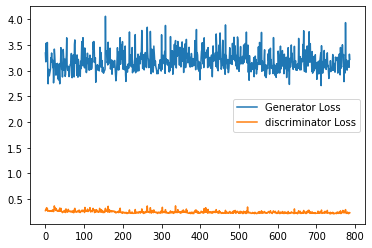

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_15750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15875: Epoch: 102: Generator loss: 3.2368517427444456, discriminator loss: 0.2373329621553421 mean disc pred on real images: 0.9199904799461365, fake images: 0.08096855878829956


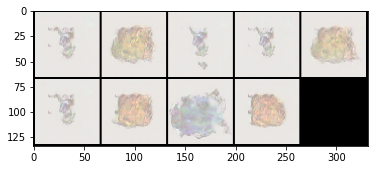

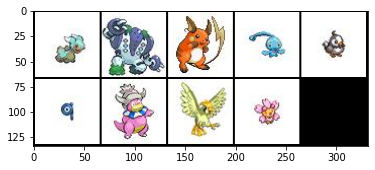

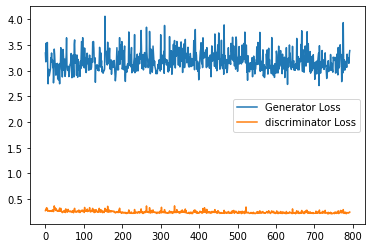

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16000: Epoch: 103: Generator loss: 3.2418457651138306, discriminator loss: 0.2416968038082123 mean disc pred on real images: 0.9135138392448425, fake images: 0.08480135351419449


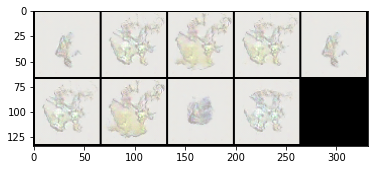

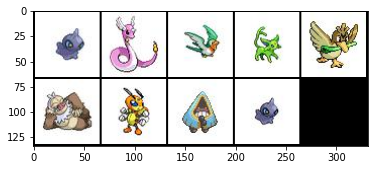

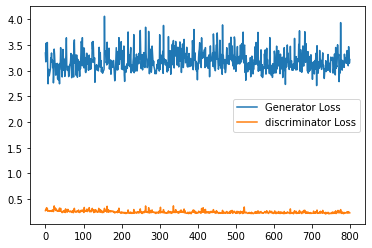

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_16000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16125: Epoch: 104: Generator loss: 3.1634291639328005, discriminator loss: 0.24469674122333526 mean disc pred on real images: 0.9143518209457397, fake images: 0.0866166353225708


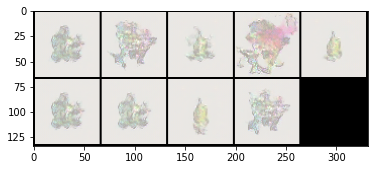

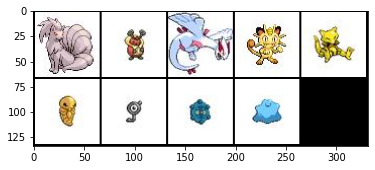

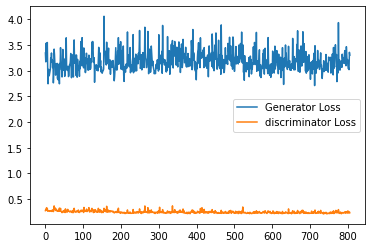

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16250: Epoch: 104: Generator loss: 2.993678645133972, discriminator loss: 0.22617884707450867 mean disc pred on real images: 0.9226234555244446, fake images: 0.0767129585146904


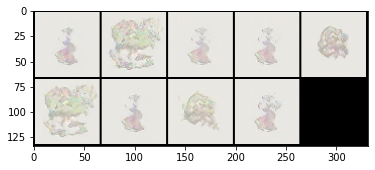

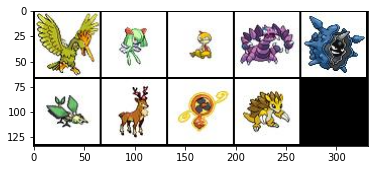

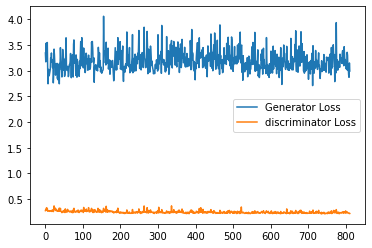

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_16250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16375: Epoch: 105: Generator loss: 3.1429782848358156, discriminator loss: 0.22925544440746307 mean disc pred on real images: 0.9222686886787415, fake images: 0.0782133936882019


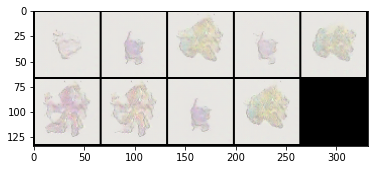

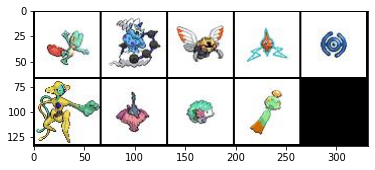

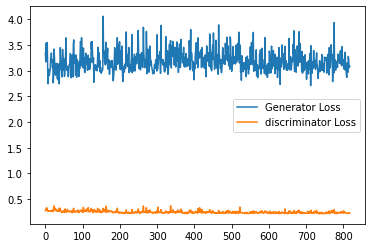

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16500: Epoch: 106: Generator loss: 3.281763671398163, discriminator loss: 0.23535220432281495 mean disc pred on real images: 0.9192461371421814, fake images: 0.08025117963552475


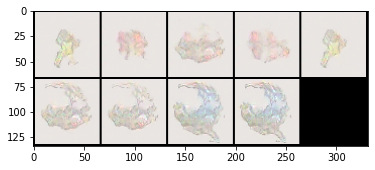

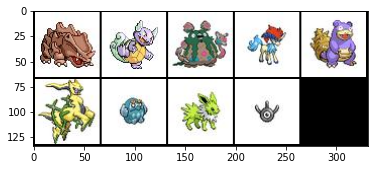

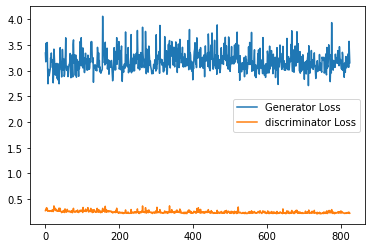

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_16500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16625: Epoch: 107: Generator loss: 3.1752193188667297, discriminator loss: 0.2271189670562744 mean disc pred on real images: 0.927659809589386, fake images: 0.0720745250582695


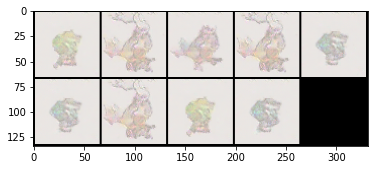

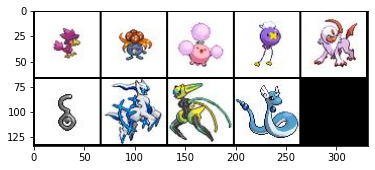

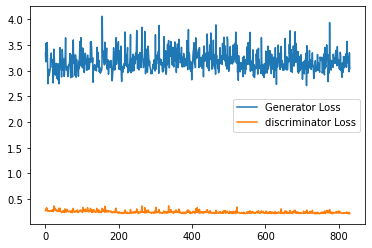

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16750: Epoch: 108: Generator loss: 3.1062861642837523, discriminator loss: 0.22496689367294312 mean disc pred on real images: 0.9251034259796143, fake images: 0.07294163107872009


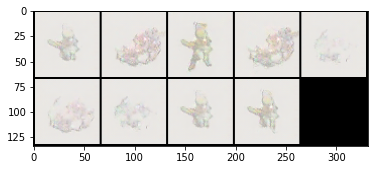

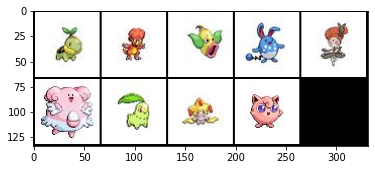

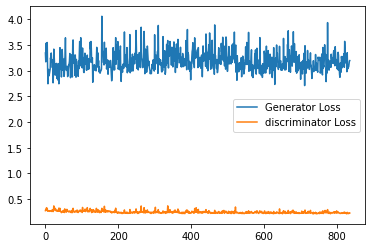

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_16750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16875: Epoch: 108: Generator loss: 3.1342103605270384, discriminator loss: 0.22767255783081056 mean disc pred on real images: 0.9238926768302917, fake images: 0.07694236189126968


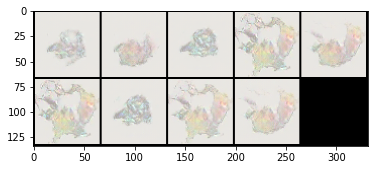

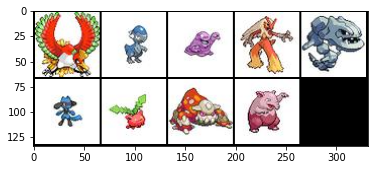

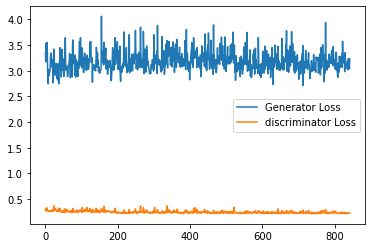

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17000: Epoch: 109: Generator loss: 3.236227346420288, discriminator loss: 0.23141571402549743 mean disc pred on real images: 0.9255245923995972, fake images: 0.07458099722862244


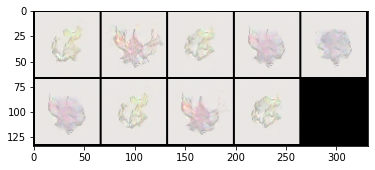

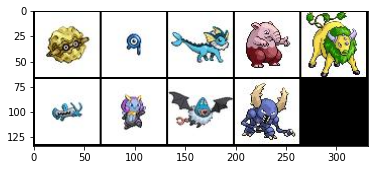

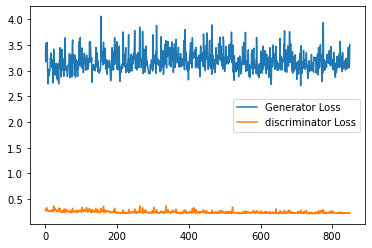

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_17000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17125: Epoch: 110: Generator loss: 3.2876459439992907, discriminator loss: 0.24157845914363862 mean disc pred on real images: 0.9173961877822876, fake images: 0.08280707895755768


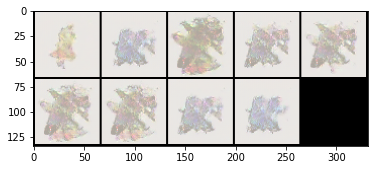

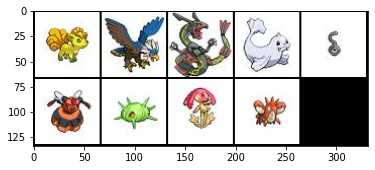

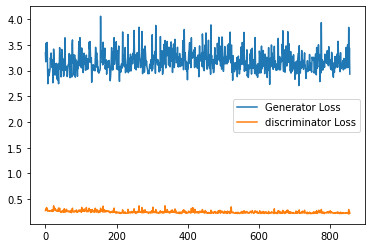

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17250: Epoch: 111: Generator loss: 3.169886199951172, discriminator loss: 0.2306998016834259 mean disc pred on real images: 0.9217193126678467, fake images: 0.07837755978107452


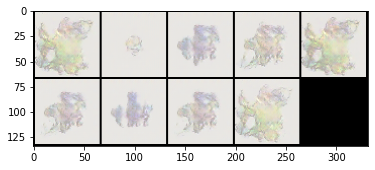

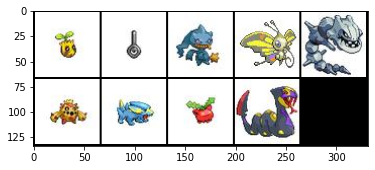

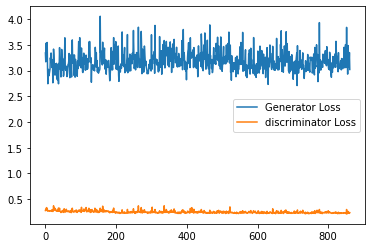

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_17250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17375: Epoch: 112: Generator loss: 3.301326661109924, discriminator loss: 0.24028779101371764 mean disc pred on real images: 0.914698600769043, fake images: 0.08482291549444199


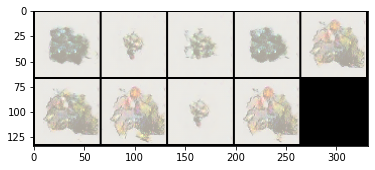

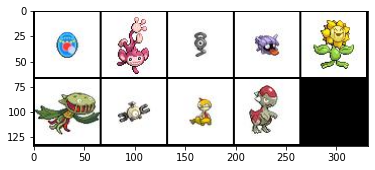

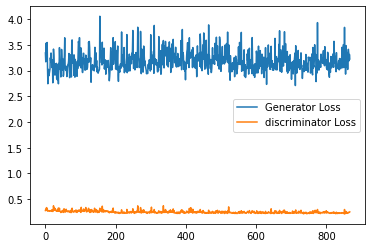

Step 17500: Epoch: 112: Generator loss: 3.288929751396179, discriminator loss: 0.24424200296401977 mean disc pred on real images: 0.9143390655517578, fake images: 0.08576337993144989


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


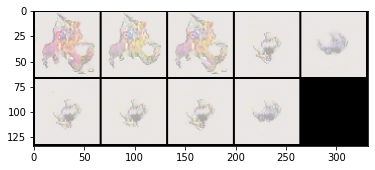

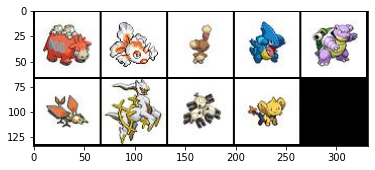

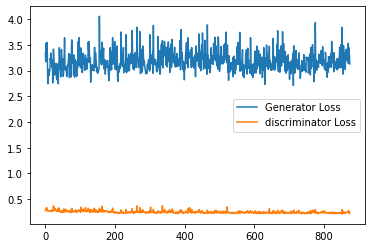

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_17500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17625: Epoch: 113: Generator loss: 3.21862464427948, discriminator loss: 0.22560606729984284 mean disc pred on real images: 0.9280635714530945, fake images: 0.06981700658798218


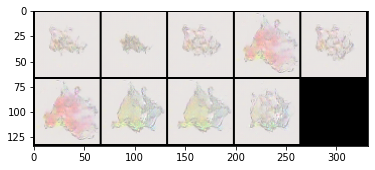

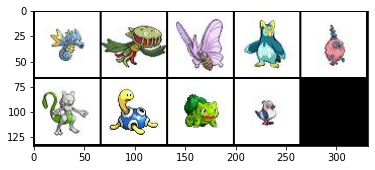

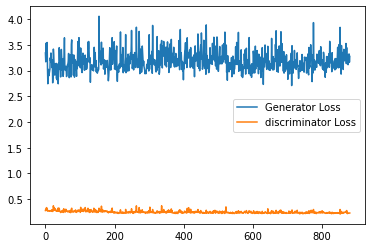

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17750: Epoch: 114: Generator loss: 3.200097046852112, discriminator loss: 0.23374378132820128 mean disc pred on real images: 0.9208422899246216, fake images: 0.07871681451797485


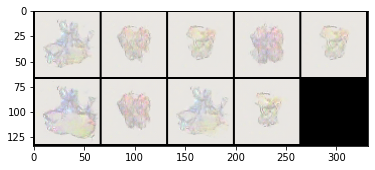

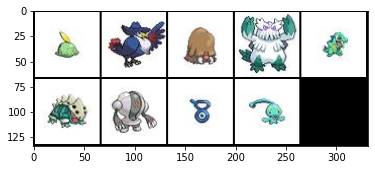

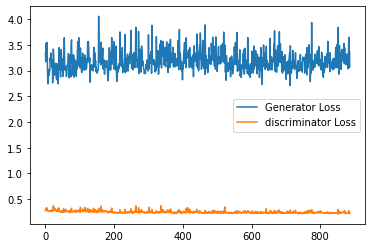

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_17750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17875: Epoch: 115: Generator loss: 3.082428936004639, discriminator loss: 0.22494642460346223 mean disc pred on real images: 0.9251271486282349, fake images: 0.07398530095815659


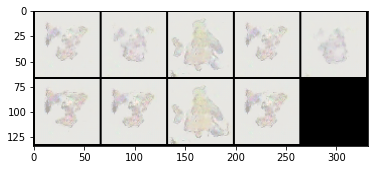

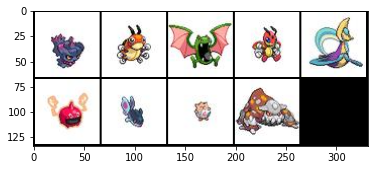

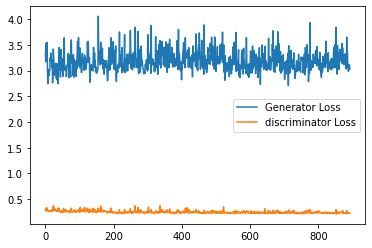

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18000: Epoch: 116: Generator loss: 3.3036517248153685, discriminator loss: 0.23342397928237915 mean disc pred on real images: 0.9222251176834106, fake images: 0.07804712653160095


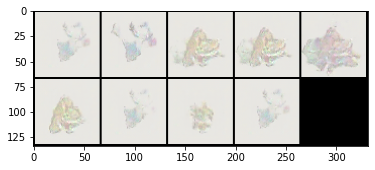

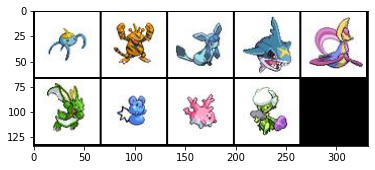

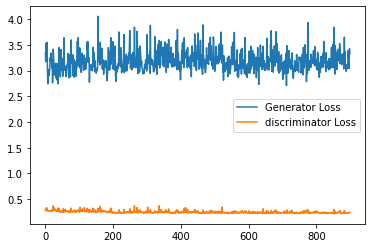

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_18000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18125: Epoch: 116: Generator loss: 3.1637798538208006, discriminator loss: 0.22219793105125427 mean disc pred on real images: 0.9305713176727295, fake images: 0.06908062845468521


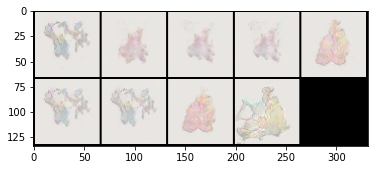

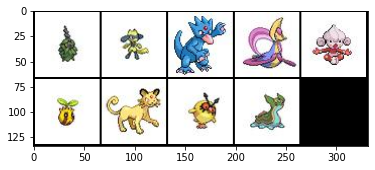

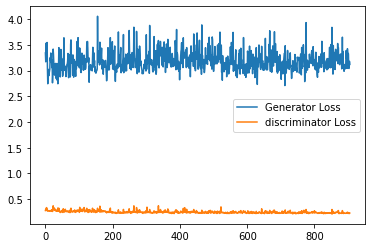

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18250: Epoch: 117: Generator loss: 3.153322305679321, discriminator loss: 0.22442813527584077 mean disc pred on real images: 0.9278692007064819, fake images: 0.0718313455581665


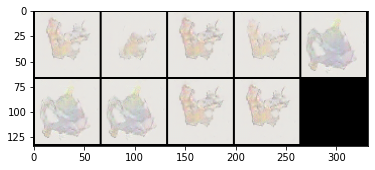

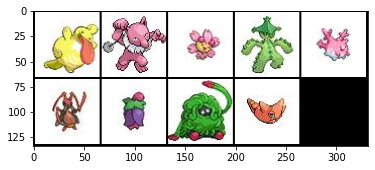

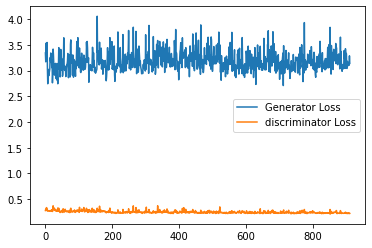

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_18250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18375: Epoch: 118: Generator loss: 3.2733540706634523, discriminator loss: 0.22514008796215057 mean disc pred on real images: 0.9283439517021179, fake images: 0.0718892365694046


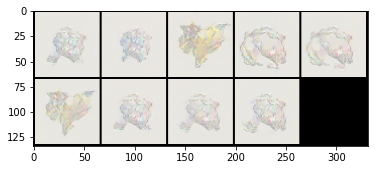

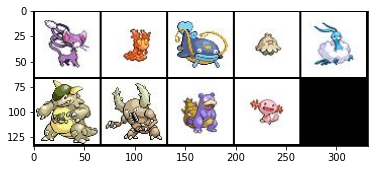

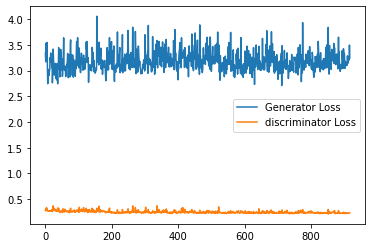

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18500: Epoch: 119: Generator loss: 3.1825445575714113, discriminator loss: 0.22574149417877198 mean disc pred on real images: 0.9289659261703491, fake images: 0.06936148554086685


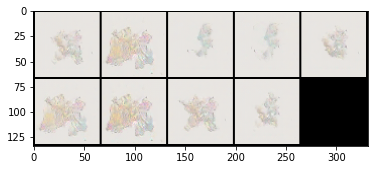

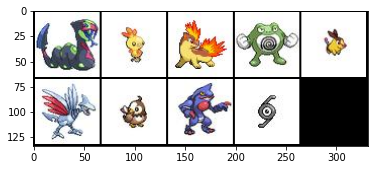

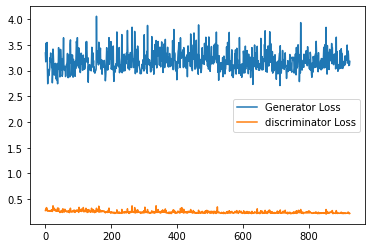

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_18500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18625: Epoch: 120: Generator loss: 3.1419510622024536, discriminator loss: 0.22387348544597627 mean disc pred on real images: 0.9271111488342285, fake images: 0.07243289053440094


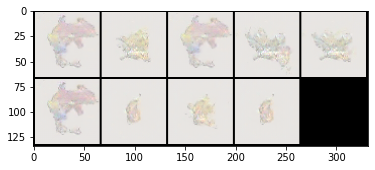

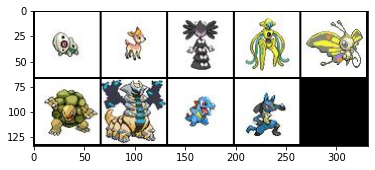

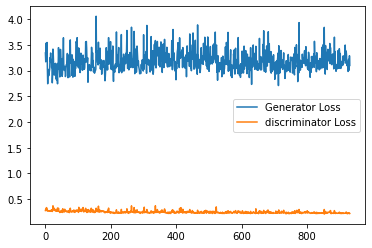

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18750: Epoch: 120: Generator loss: 3.070084143638611, discriminator loss: 0.2195773593187332 mean disc pred on real images: 0.9346621632575989, fake images: 0.06626617908477783


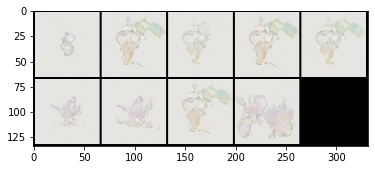

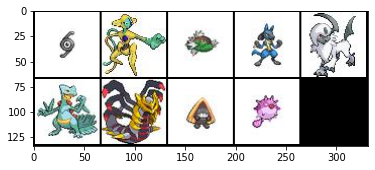

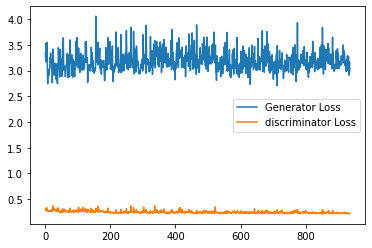

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_18750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18875: Epoch: 121: Generator loss: 3.1013089904785156, discriminator loss: 0.22142367172241212 mean disc pred on real images: 0.9272964000701904, fake images: 0.07161770761013031


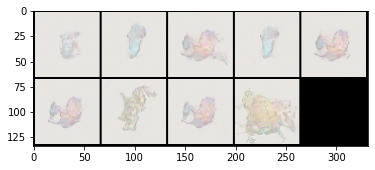

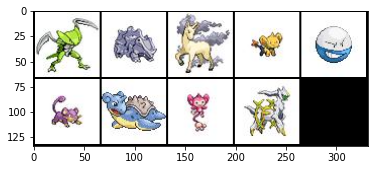

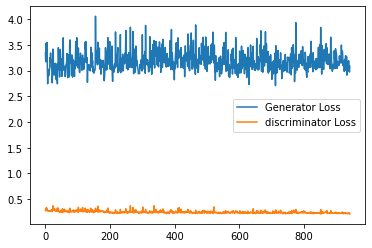

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19000: Epoch: 122: Generator loss: 3.38857479763031, discriminator loss: 0.2487059873342514 mean disc pred on real images: 0.9129849076271057, fake images: 0.08913485705852509


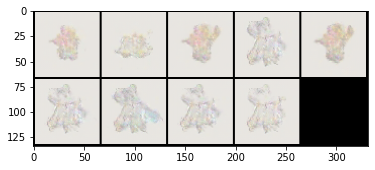

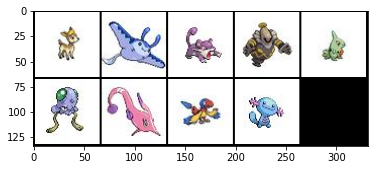

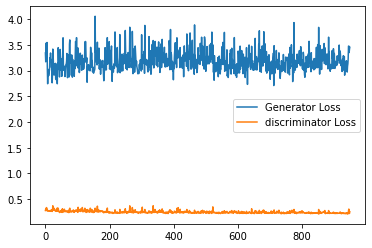

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_19000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19125: Epoch: 123: Generator loss: 3.14176145362854, discriminator loss: 0.2246117115020752 mean disc pred on real images: 0.927193284034729, fake images: 0.0720650851726532


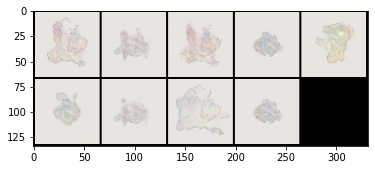

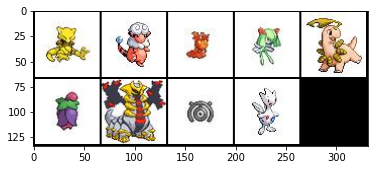

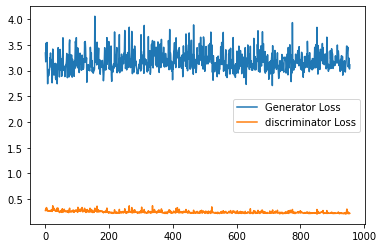

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19250: Epoch: 124: Generator loss: 3.138278561592102, discriminator loss: 0.22217868757247924 mean disc pred on real images: 0.9307999014854431, fake images: 0.07041764259338379


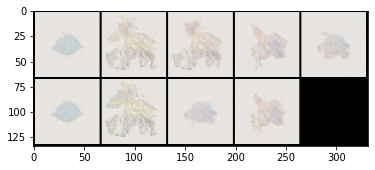

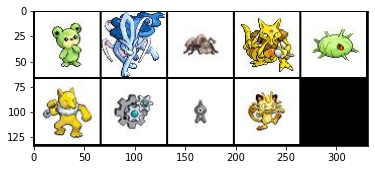

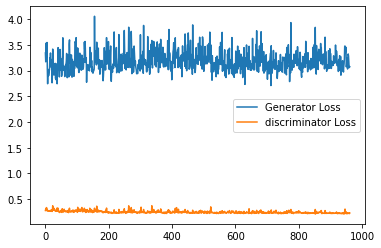

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_19250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


Step 19375: Epoch: 125: Generator loss: 3.154629559516907, discriminator loss: 0.22985048735141755 mean disc pred on real images: 0.9222736954689026, fake images: 0.08095503598451614


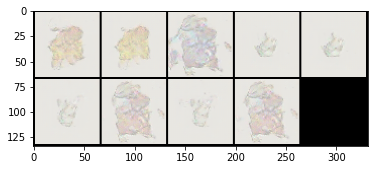

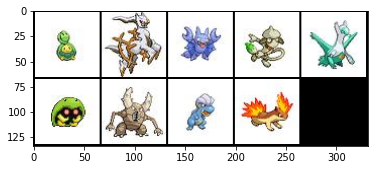

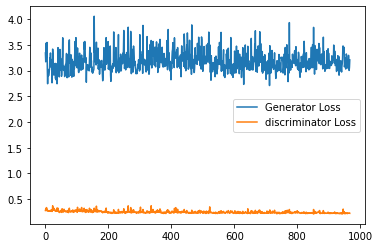

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19500: Epoch: 125: Generator loss: 3.172591181755066, discriminator loss: 0.2333452812433243 mean disc pred on real images: 0.9210332632064819, fake images: 0.07685426622629166


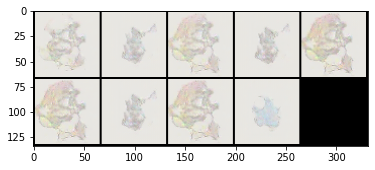

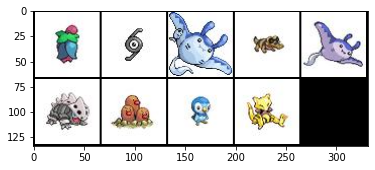

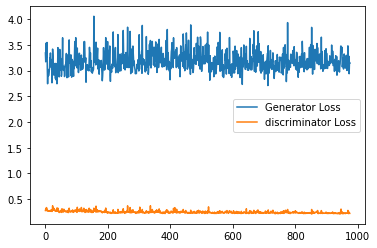

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_19500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19625: Epoch: 126: Generator loss: 3.1296298694610596, discriminator loss: 0.2236725038290024 mean disc pred on real images: 0.9261603355407715, fake images: 0.07344339787960052


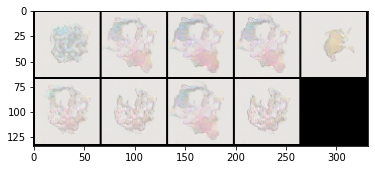

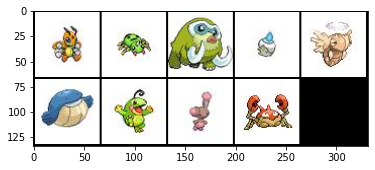

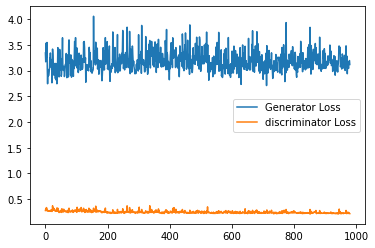

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19750: Epoch: 127: Generator loss: 3.210268539428711, discriminator loss: 0.24545729160308838 mean disc pred on real images: 0.9200270771980286, fake images: 0.08097194880247116


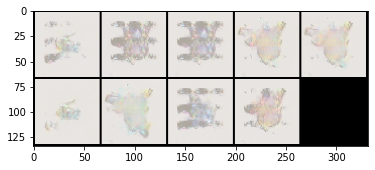

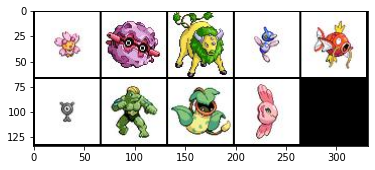

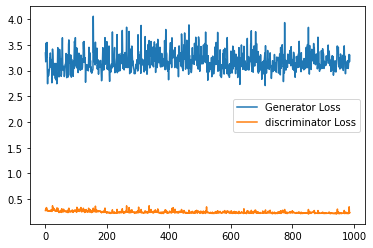

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_19750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19875: Epoch: 128: Generator loss: 3.3003410778045654, discriminator loss: 0.22300589847564697 mean disc pred on real images: 0.9274392127990723, fake images: 0.07283765077590942


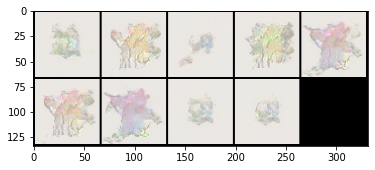

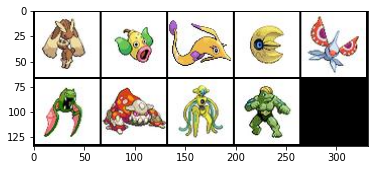

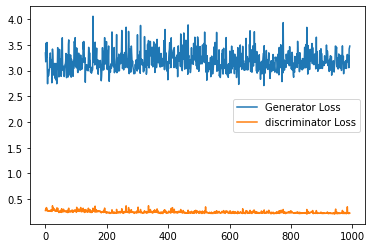

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20000: Epoch: 129: Generator loss: 3.14479692029953, discriminator loss: 0.2595014741420746 mean disc pred on real images: 0.9066935181617737, fake images: 0.09096755087375641


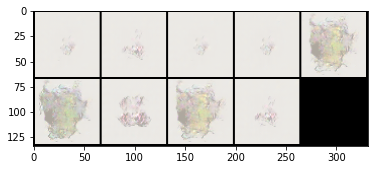

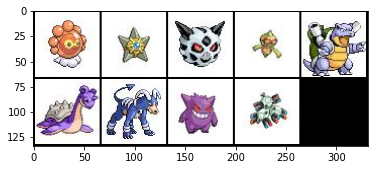

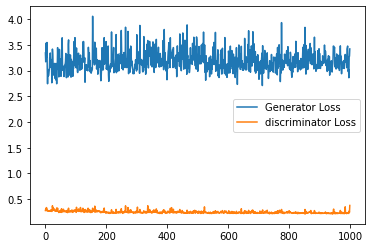

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_20000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20125: Epoch: 129: Generator loss: 3.1485912885665894, discriminator loss: 0.23515807640552522 mean disc pred on real images: 0.9146898984909058, fake images: 0.0875362828373909


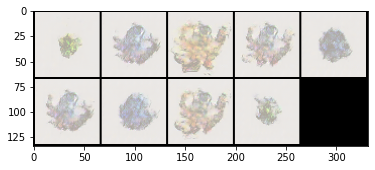

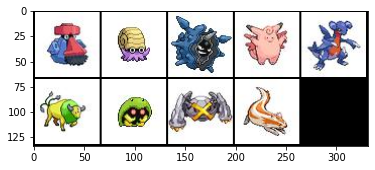

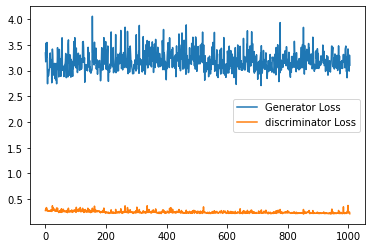

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20250: Epoch: 130: Generator loss: 3.132246150970459, discriminator loss: 0.24126705157756806 mean disc pred on real images: 0.9141827821731567, fake images: 0.08562050759792328


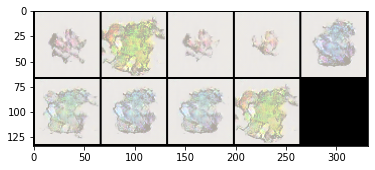

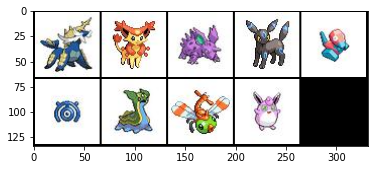

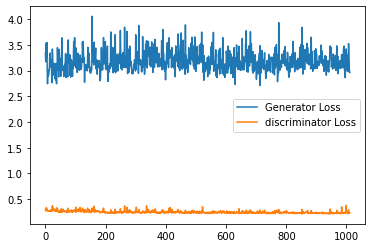

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_20250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20375: Epoch: 131: Generator loss: 3.0859852752685546, discriminator loss: 0.23979476010799408 mean disc pred on real images: 0.9117997884750366, fake images: 0.08734048902988434


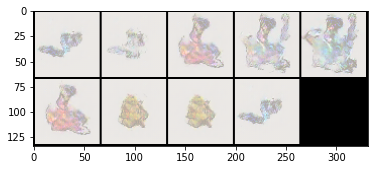

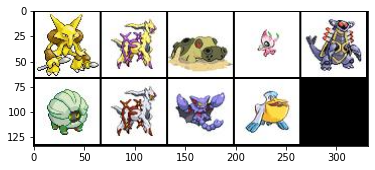

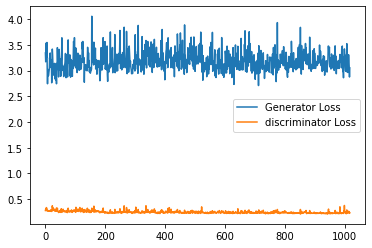

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20500: Epoch: 132: Generator loss: 3.043308666229248, discriminator loss: 0.23320389902591707 mean disc pred on real images: 0.9154500365257263, fake images: 0.0840221419930458


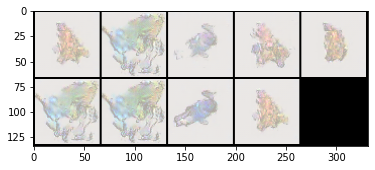

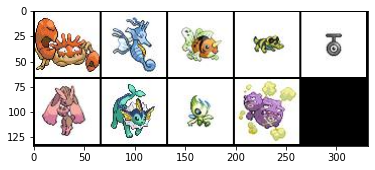

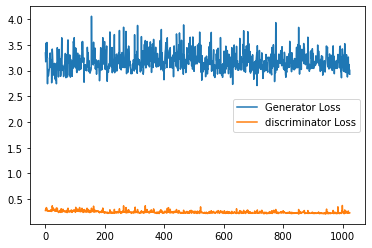

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_20500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20625: Epoch: 133: Generator loss: 3.116928924560547, discriminator loss: 0.22756333100795745 mean disc pred on real images: 0.9244220852851868, fake images: 0.0764213353395462


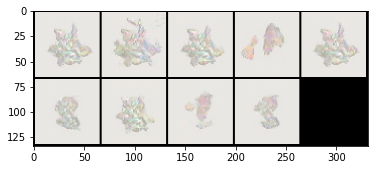

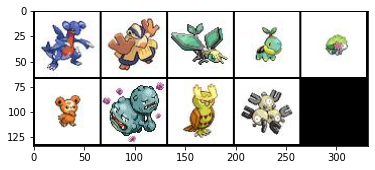

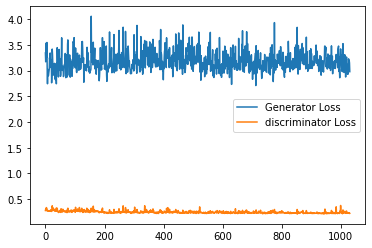

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20750: Epoch: 133: Generator loss: 3.167062268972397, discriminator loss: 0.2330203527212143 mean disc pred on real images: 0.9233953356742859, fake images: 0.07596704363822937


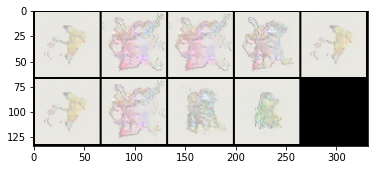

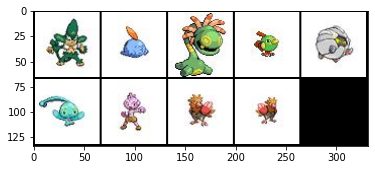

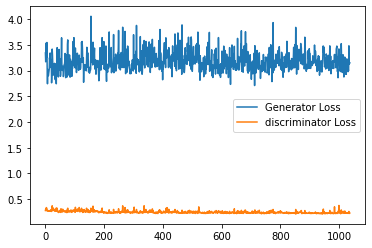

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_20750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20875: Epoch: 134: Generator loss: 3.079452877998352, discriminator loss: 0.22302619075775146 mean disc pred on real images: 0.9278669953346252, fake images: 0.07398858666419983


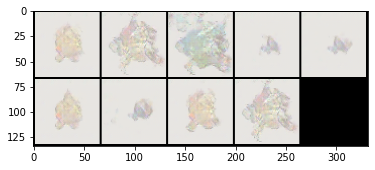

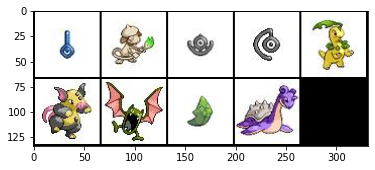

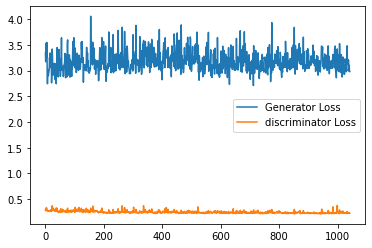

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21000: Epoch: 135: Generator loss: 3.259875805854797, discriminator loss: 0.23962342476844786 mean disc pred on real images: 0.9209225177764893, fake images: 0.080227330327034


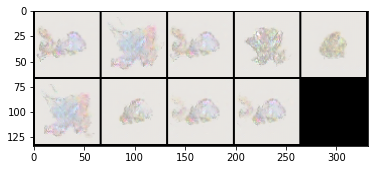

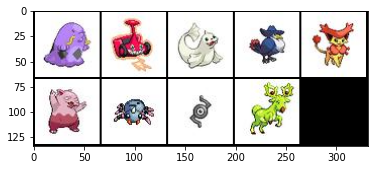

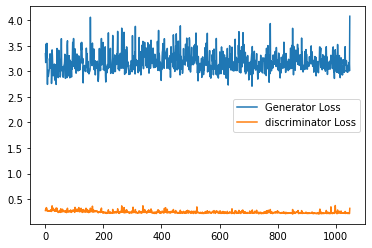

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_21000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21125: Epoch: 136: Generator loss: 3.0531818227767946, discriminator loss: 0.2245171332359314 mean disc pred on real images: 0.9245116114616394, fake images: 0.07367460429668427


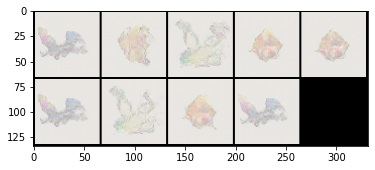

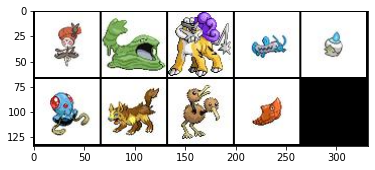

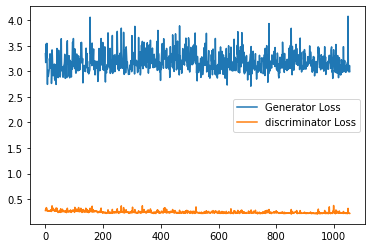

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21250: Epoch: 137: Generator loss: 3.119298451423645, discriminator loss: 0.2226616438627243 mean disc pred on real images: 0.9267871379852295, fake images: 0.07255041599273682


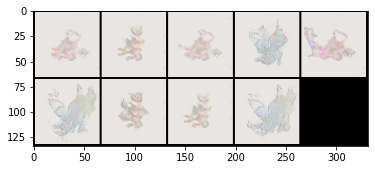

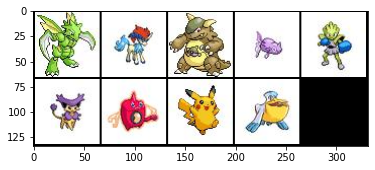

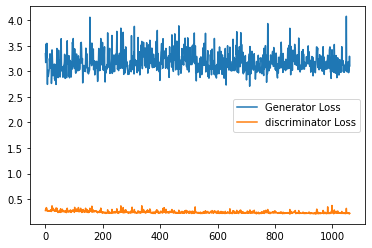

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_21250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21375: Epoch: 137: Generator loss: 3.1496662311553956, discriminator loss: 0.22800560784339904 mean disc pred on real images: 0.9254114031791687, fake images: 0.07394963502883911


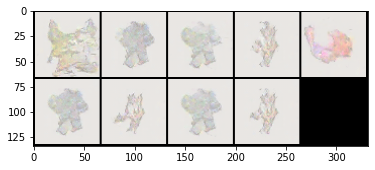

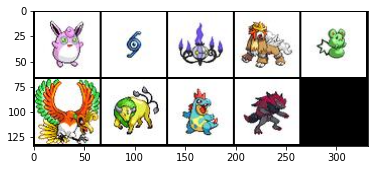

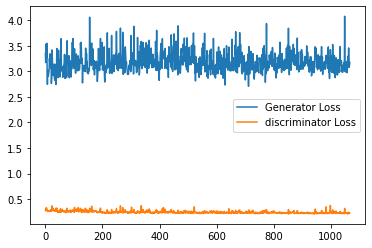

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21500: Epoch: 138: Generator loss: 3.095303056716919, discriminator loss: 0.2187840120792389 mean disc pred on real images: 0.9310196042060852, fake images: 0.06929077953100204


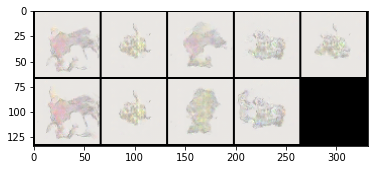

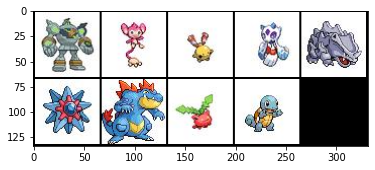

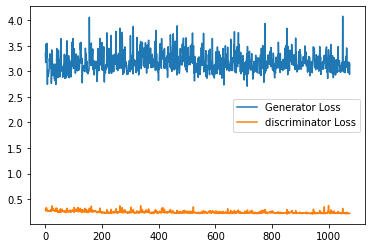

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_21500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21625: Epoch: 139: Generator loss: 3.1866814208030703, discriminator loss: 0.23410062539577484 mean disc pred on real images: 0.9248694181442261, fake images: 0.07623034715652466


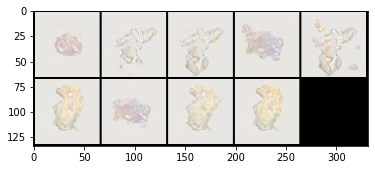

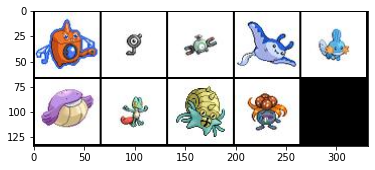

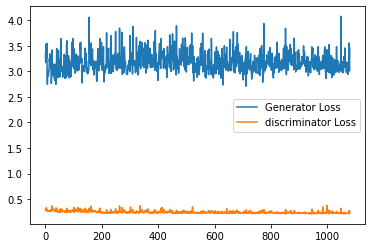

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21750: Epoch: 140: Generator loss: 3.0554941720962523, discriminator loss: 0.21743151676654815 mean disc pred on real images: 0.9326255917549133, fake images: 0.06767095625400543


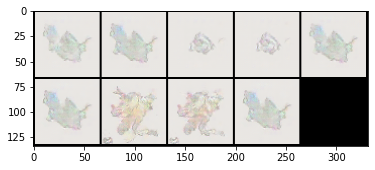

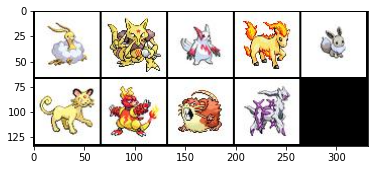

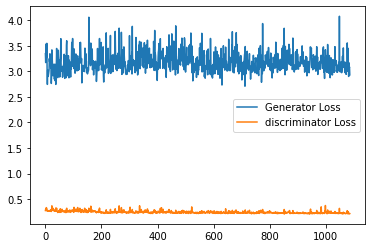

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_21750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21875: Epoch: 141: Generator loss: 3.322849771142006, discriminator loss: 0.24294809937477113 mean disc pred on real images: 0.9154400825500488, fake images: 0.0832073986530304


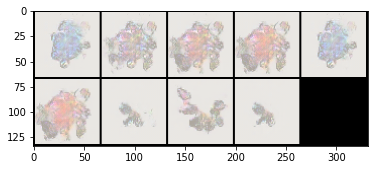

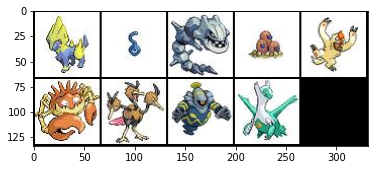

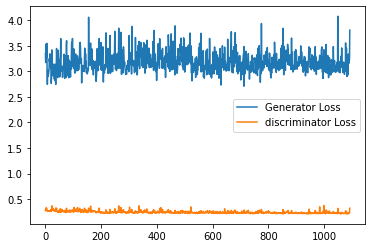

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22000: Epoch: 141: Generator loss: 3.2503804779052734, discriminator loss: 0.2334964256286621 mean disc pred on real images: 0.9171632528305054, fake images: 0.08205841481685638


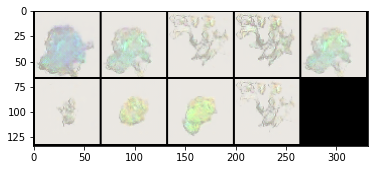

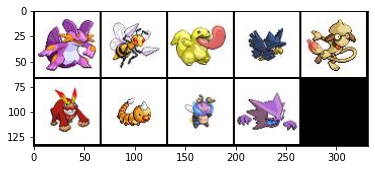

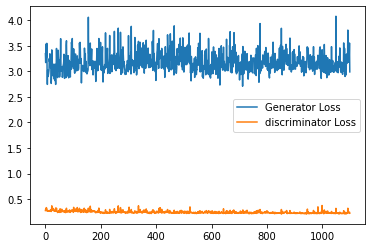

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_22000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22125: Epoch: 142: Generator loss: 3.1812632675170898, discriminator loss: 0.23504352259635924 mean disc pred on real images: 0.9204608201980591, fake images: 0.08219059556722641


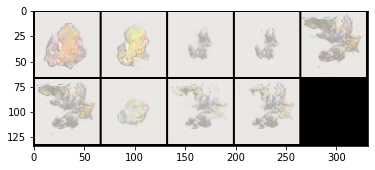

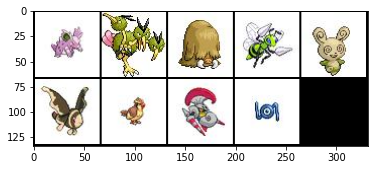

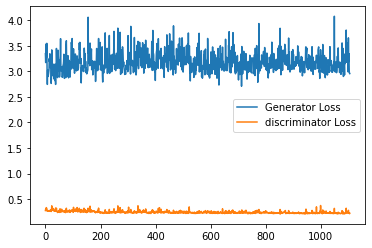

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22250: Epoch: 143: Generator loss: 3.2045185737609865, discriminator loss: 0.23602335751056672 mean disc pred on real images: 0.9208089113235474, fake images: 0.07980971038341522


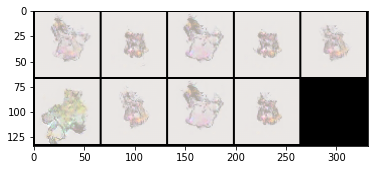

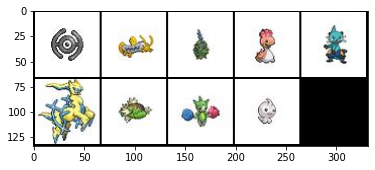

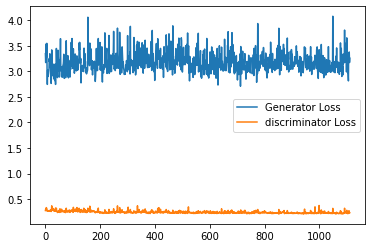

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_22250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22375: Epoch: 144: Generator loss: 3.0725403709411623, discriminator loss: 0.22594147777557372 mean disc pred on real images: 0.9251269102096558, fake images: 0.07278233021497726


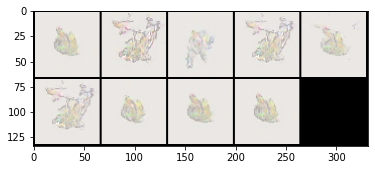

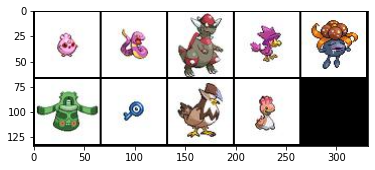

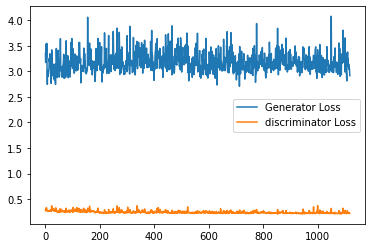

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/155 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22500: Epoch: 145: Generator loss: 3.0325592288970946, discriminator loss: 0.22302647149562835 mean disc pred on real images: 0.9263953566551208, fake images: 0.07259859144687653


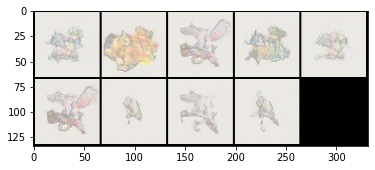

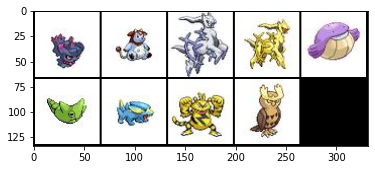

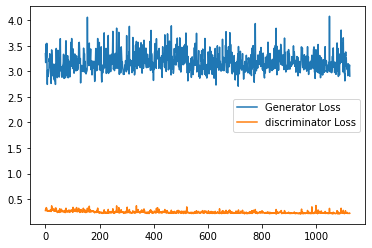

Saving intermediate model with name dcgan_standard_fmap_gen_64_disc_30_noisy_disc_loss_22500.pt !


In [ ]:
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

cur_step = 0
generator_losses = []
discriminator_losses = []
discriminator_fake_preds = [] # median value of P(real) the discriminator predicts on the fake images (per batch)
discriminator_real_preds = [] # median value of P(real) the discriminator predicts on the real images (per batch)


for epoch in range(n_epochs):
    # Dataloader returns the (real_images, labels)
    for real, true_labels in tqdm(pkmn_dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_discriminator_loss = 0
        for _ in range(disc_repeats):
            ### Update discriminator ###
            disc_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            disc_fake_pred = disc(fake.detach())
            disc_real_pred = disc(real)

            # compute discriminator loss
            disc_loss = disc_loss_func(disc_fake_pred, disc_real_pred)

            # Keep track of the average discriminator loss in this batch
            mean_iteration_discriminator_loss += disc_loss.item() / disc_repeats
            # Update gradients
            # when using WGAN, we have retain_graph = True, but it probably takes longer
            disc_loss.backward(retain_graph=False)
            # Update optimizer
            disc_opt.step()
            
        discriminator_losses += [mean_iteration_discriminator_loss]
        discriminator_fake_preds += [torch.mean(disc_fake_pred)]
        discriminator_real_preds += [torch.mean(disc_real_pred)]

        ### Update generator ###
        # todo: add the ability to do this in a loop
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        disc_fake_pred = disc(fake_2)
        
        # compute gen loss
        gen_loss = gen_loss_func(disc_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]
        

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            # maybe print out the last values here ? To see how stable it is overtime ? These all seem to be very close to 0.5 / 1
            disc_prediction_real = sum(discriminator_real_preds[-display_step:]) / display_step
            disc_prediction_fake = sum(discriminator_fake_preds[-display_step:]) / display_step
            print(f"Step {cur_step}: Epoch: {epoch}: Generator loss: {gen_mean}, discriminator loss: {disc_mean} mean disc pred on real images: {disc_prediction_real}, fake images: {disc_prediction_fake}")
            show_tensor_images(fake[0:imgs_to_display], imgs_to_display, size = (3,64,64), denorm_transform = denorm_transform)
            show_tensor_images(real[0:imgs_to_display], imgs_to_display, size = (3,64,64), denorm_transform = denorm_transform)
            step_bins = 20
            
            # todo: add proper labels to this plot
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="discriminator Loss"
            )
            plt.legend()
            plt.show()
            
            if save_at_display and cur_step % (display_step * 2) == 0:
              outfile_name = "{}_{}.pt".format(save_prefix, cur_step)
              print("Saving intermediate model with name {} !".format(outfile_name))
              save_model(gen, outfile_name)

        cur_step += 1

In [70]:
# Save the final model

out_file = "second_gan_with_standard_dcgan_arch_after_149epochs.pt"
  
#save_model(gen, out_file)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Shape of fake images are: torch.Size([10, 3, 64, 64])


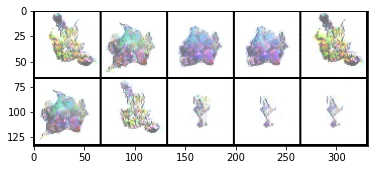

In [87]:
# Load model for inference

gen.load_state_dict(torch.load("dcgan_standard_snapshots/{}".format(out_file)))

# Performing inference - actually, maybe I ran some other cell after this so it's not really well defined
num_samples = 10

sample_vector = get_noise(num_samples, z_dim)

fake_images = gen(sample_vector)

print("Shape of fake images are: {}".format(fake_images.shape))

output_size = gen.output_dim
# + 0.9
show_tensor_images(fake_images, num_images=num_samples, size=(1,256, 256), use_uniform_transform = True, denorm_transform = None)

In [ ]:
# Originally, the image is in the [0, 1] space
# After some normalization, it's another another space, hopefully around N(0,1)
# but we undo that transformation, so theorectically, we should be back in the [0, 1] space
# maybe we can use a feature matching loss as well ?